## Import Libraries

In [1]:
!pip3 install opencv-contrib-python==4.2.0.32

     |████████████████████████████████| 34.2 MB 17 kB/s 
  Attempting uninstall: opencv-contrib-python
    Found existing installation: opencv-contrib-python 4.1.2.30
    Uninstalling opencv-contrib-python-4.1.2.30:
      Successfully uninstalled opencv-contrib-python-4.1.2.30


In [2]:
import math
import cv2
import csv
import collections
import numpy as np
from google.colab.patches import cv2_imshow
import requests
import base64
import io
from PIL import Image

In [9]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Tracker

In [10]:
class EuclideanDistTracker:
    def __init__(self):
        # Store the center positions of the objects
        self.center_points = {}
        # Keep the count of the IDs
        # each time a new object id detected, the count will increase by one
        self.id_count = 0

    def update(self, objects_rect):
        # Objects boxes and ids
        objects_bbs_ids = []

        # Get center point of new object
        for rect in objects_rect:
            x, y, w, h, index = rect
            cx = (x + x + w) // 2
            cy = (y + y + h) // 2

            # Find out if that object was detected already
            same_object_detected = False
            for id, pt in self.center_points.items():
                dist = math.hypot(cx - pt[0], cy - pt[1])

                if dist < 25: # Threshold
                    self.center_points[id] = (cx, cy)
                    # print(self.center_points)
                    objects_bbs_ids.append([x, y, w, h, id, index])
                    same_object_detected = True
                    break

            # New object is detected we assign the ID to that object
            if same_object_detected is False:
                self.center_points[self.id_count] = (cx, cy)
                objects_bbs_ids.append([x, y, w, h, self.id_count, index])
                self.id_count += 1

        # Clean the dictionary by center points to remove IDS not used anymore
        new_center_points = {}
        for obj_bb_id in objects_bbs_ids:
            _, _, _, _, object_id, index = obj_bb_id
            center = self.center_points[object_id]
            new_center_points[object_id] = center

        # Update dictionary with IDs not used removed
        self.center_points = new_center_points.copy()
        return objects_bbs_ids

In [11]:
def ad(a, b):
    return a + b

## Vehicle Count

In [12]:
# Initialize Tracker
tracker = EuclideanDistTracker()

# Initialize the videocapture object
cap = cv2.VideoCapture('/content/drive/MyDrive/AI/Frequency count part/vehicle-detection-classification-opencv.zip (Unzipped Files)/video_Trim.mp4')
input_size = 320

# Detection confidence threshold
confThreshold =0.2
nmsThreshold= 0.2

font_color = (0, 0, 255)
font_size = 0.5
font_thickness = 2

# Middle cross line position
middle_line_position = 225   
up_line_position = middle_line_position - 15
down_line_position = middle_line_position + 15


# Store Coco Names in a list
classesFile = "/content/drive/MyDrive/AI/Frequency count part/vehicle-detection-classification-opencv.zip (Unzipped Files)/coco.names"
classNames = open(classesFile).read().strip().split('\n')
print(classNames)
print(len(classNames))

# class index for our required detection classes
required_class_index = [2, 3, 5, 7]

detected_classNames = []

## Model Files
modelConfiguration = '/content/drive/MyDrive/AI/Frequency count part/vehicle-detection-classification-opencv.zip (Unzipped Files)/yolov3-320.cfg'
modelWeigheights = '/content/drive/MyDrive/AI/Frequency count part/vehicle-detection-classification-opencv.zip (Unzipped Files)/yolov3-320.weights'

# configure the network model
net = cv2.dnn.readNetFromDarknet(modelConfiguration, modelWeigheights)

# Configure the network backend

net.setPreferableBackend(cv2.dnn.DNN_BACKEND_CUDA)
net.setPreferableTarget(cv2.dnn.DNN_TARGET_CUDA)

# Define random colour for each class

np.random.seed(42)
colors = np.random.randint(0, 255, size=(len(classNames), 3), dtype='uint8')

['person', 'bicycle', 'car', 'motorbike', 'aeroplane', 'bus', 'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket', 'bottle', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'sofa', 'pottedplant', 'bed', 'diningtable', 'toilet', 'tvmonitor', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush']
80


In [13]:
# Function for finding the center of a rectangle
def find_center(x, y, w, h):
    x1=int(w/2)
    y1=int(h/2)
    cx = x+x1
    cy=y+y1
    return cx, cy
    
# List for store vehicle count information
temp_up_list = []
temp_down_list = []
up_list = [0, 0, 0, 0]
down_list = [0, 0, 0, 0]

In [14]:
# Function for count vehicle
def count_vehicle(box_id, img):

    x, y, w, h, id, index = box_id

    # Find the center of the rectangle for detection
    center = find_center(x, y, w, h)
    ix, iy = center
    
    # Find the current position of the vehicle
    if (iy > up_line_position) and (iy < middle_line_position):

        if id not in temp_up_list:
            temp_up_list.append(id)

    elif iy < down_line_position and iy > middle_line_position:
        if id not in temp_down_list:
            temp_down_list.append(id)
            
    elif iy < up_line_position:
        if id in temp_down_list:
            temp_down_list.remove(id)
            up_list[index] = up_list[index]+1

    elif iy > down_line_position:
        if id in temp_up_list:
            temp_up_list.remove(id)
            down_list[index] = down_list[index] + 1

    # Draw circle in the middle of the rectangle
    cv2.circle(img, center, 2, (0, 0, 255), -1)  # end here
    # print(up_list, down_list)

In [23]:
def postProcess(outputs, img):
    detection = []
    global detected_classNames
    for i in outputs['predictions']:
        x, y, w, h = i['x'],i['y'],i['width'],i['height']
        # print(x,y,w,h)
        x, y, w, h = int(x), int(y), int(w), int(h)
        classes={"2":2,"Bike":3,"7":5,"4":7}
        color = (255,0,0)
        name = i['class']
        detected_classNames.append(name)
        score=int(i['confidence']*100)
        # Draw classname and confidence score 
        cv2.putText(img, f'{name.upper()} {score}%',(x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 1)

        # Draw bounding rectangle
        cv2.rectangle(img, (x, y), (x + w, y + h), 3, 1)
        detection.append([x, y, w, h, classes[i['class']]])

    # Update the tracker for each object
    boxes_ids = tracker.update(detection)
    for box_id in boxes_ids:
        count_vehicle(box_id, img)

In [19]:
def plot_boxes(image):
  # Load Image with PIL
  image = Image.fromarray(image)
  # Convert to JPEG Buffer
  buffered = io.BytesIO()
  image.save(buffered, quality=90, format="JPEG")
  # Base 64 Encode
  img_str = base64.b64encode(buffered.getvalue())
  img_str = img_str.decode("ascii")
  # Construct the URL
  upload_url = "".join([
      "https://detect.roboflow.com/vehicle-detection-dthjh/2",
      "?api_key=vXf4bJSggptvU7oJpimb",
      "&name=YOUR_IMAGE.jpg"
  ])
  # POST to the API
  r = requests.post(upload_url, data=img_str, headers={
      "Content-Type": "application/x-www-form-urlencoded"
  })
  # Output result
  return r.json()

In [21]:
def realTime():
    while True:
        success, img = cap.read()
        if img is None:
          break
        img = cv2.resize(img, (0, 0), None, 0.5, 0.5)
        ih, iw, channels = img.shape
        outputs = plot_boxes(img)
        print(outputs)
        postProcess(outputs, img)
        # break
        # # Find the objects from the network output

        # # Draw the crossing lines

        cv2.line(img, (0, middle_line_position), (iw, middle_line_position), (255, 0, 255), 2)
        cv2.line(img, (0, up_line_position), (iw, up_line_position), (0, 0, 255), 2)
        cv2.line(img, (0, down_line_position), (iw, down_line_position), (0, 0, 255), 2)

        # Draw counting texts in the frame
        cv2.putText(img, "Up", (110, 20), cv2.FONT_HERSHEY_SIMPLEX, font_size, font_color, font_thickness)
        cv2.putText(img, "Down", (160, 20), cv2.FONT_HERSHEY_SIMPLEX, font_size, font_color, font_thickness)
        cv2.putText(img, "Car:        " + str(up_list[0]) + "     " + str(down_list[0]), (20, 40),
                    cv2.FONT_HERSHEY_SIMPLEX, font_size, font_color, font_thickness)
        cv2.putText(img, "Bike:        " + str(up_list[1]) + "     " + str(down_list[1]), (20, 60),
                    cv2.FONT_HERSHEY_SIMPLEX, font_size, font_color, font_thickness)
        cv2.putText(img, "Bus:        " + str(up_list[2]) + "     " + str(down_list[2]), (20, 80),
                    cv2.FONT_HERSHEY_SIMPLEX, font_size, font_color, font_thickness)
        cv2.putText(img, "Truck:      " + str(up_list[3]) + "     " + str(down_list[3]), (20, 100),
                    cv2.FONT_HERSHEY_SIMPLEX, font_size, font_color, font_thickness)

        # # Show the frames
        cv2_imshow(img)
        # out = cv2.VideoWriter('shantanu_chutiya.avi',cv2.VideoWriter_fourcc(*'XVID'), 8, (302,302))
        # out.write(img) 

        # if cv2.waitKey(1) == ord('q'):
        #     break

    return 0
    # Write the vehicle counting information in a file and save it
    out.release()
    with open("data.csv", 'w') as f1:
        cwriter = csv.writer(f1)
        cwriter.writerow(['Direction', 'car', 'motorbike', 'bus', 'truck'])
        up_list.insert(0, "Up")
        down_list.insert(0, "Down")
        cwriter.writerow(up_list)
        cwriter.writerow(down_list)
    f1.close()
    # print("Data saved at 'data.csv'")
    # Finally realese the capture object and destroy all active windows
    cap.release()
    cv2.destroyAllWindows()

{'predictions': [{'x': 238.5, 'y': 255.0, 'width': 53, 'height': 54, 'class': '2', 'confidence': 0.637}, {'x': 234.0, 'y': 192.5, 'width': 18, 'height': 37, 'class': '2', 'confidence': 0.445}]}


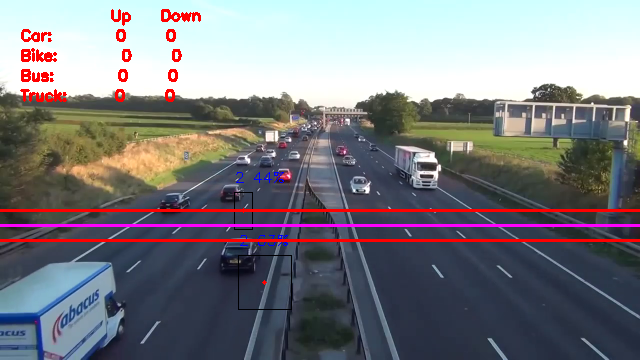

{'predictions': [{'x': 237.0, 'y': 250.5, 'width': 40, 'height': 65, 'class': '2', 'confidence': 0.41}]}


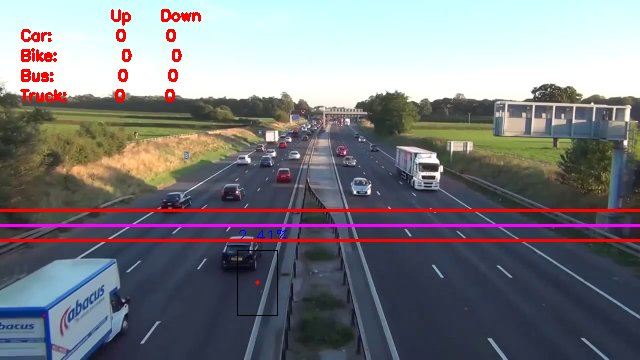

{'predictions': [{'x': 240.5, 'y': 250.0, 'width': 45, 'height': 50, 'class': '2', 'confidence': 0.641}]}


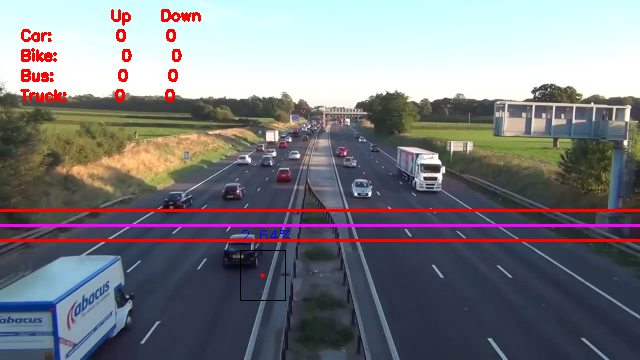

{'predictions': [{'x': 244.0, 'y': 247.0, 'width': 38, 'height': 50, 'class': '2', 'confidence': 0.507}]}


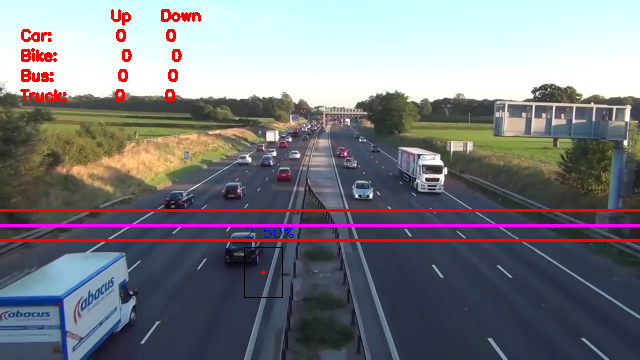

{'predictions': [{'x': 244.0, 'y': 247.0, 'width': 38, 'height': 50, 'class': '2', 'confidence': 0.51}]}


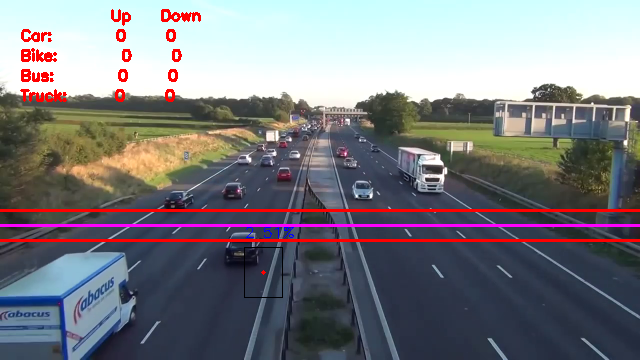

{'predictions': [{'x': 243.0, 'y': 243.5, 'width': 40, 'height': 51, 'class': '2', 'confidence': 0.472}]}


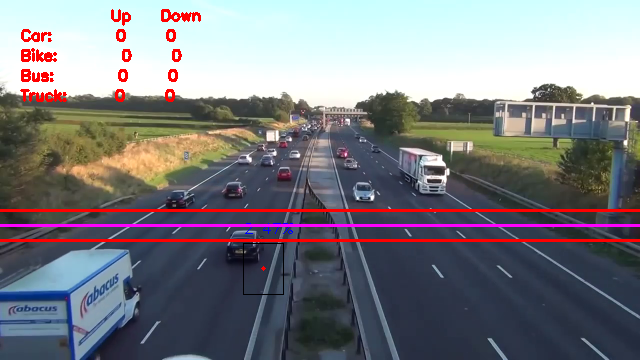

{'predictions': [{'x': 244.0, 'y': 241.5, 'width': 42, 'height': 49, 'class': '2', 'confidence': 0.481}, {'x': 425.0, 'y': 168.0, 'width': 54, 'height': 52, 'class': '4', 'confidence': 0.425}]}


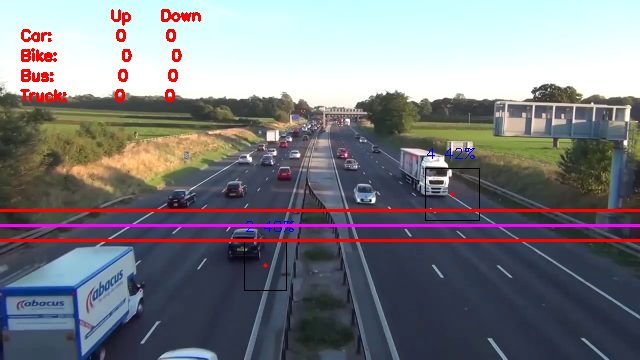

{'predictions': [{'x': 247.0, 'y': 241.5, 'width': 48, 'height': 49, 'class': '2', 'confidence': 0.608}, {'x': 430.5, 'y': 170.0, 'width': 55, 'height': 54, 'class': '4', 'confidence': 0.417}]}


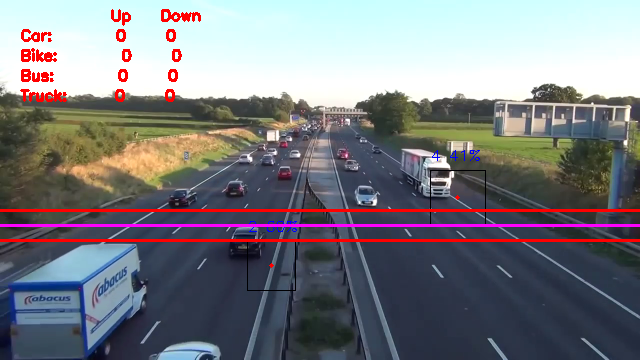

{'predictions': [{'x': 247.5, 'y': 240.0, 'width': 43, 'height': 50, 'class': '2', 'confidence': 0.56}, {'x': 428.0, 'y': 170.5, 'width': 74, 'height': 55, 'class': '4', 'confidence': 0.417}]}


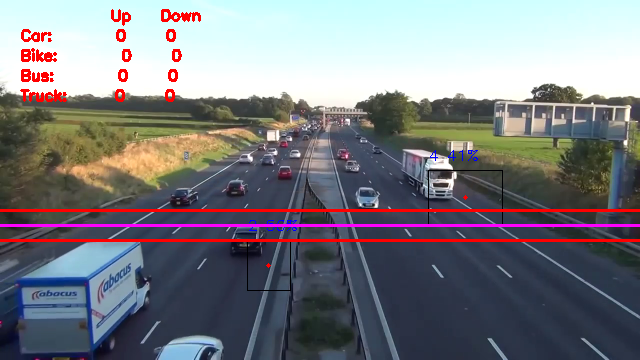

{'predictions': [{'x': 248.5, 'y': 238.5, 'width': 41, 'height': 49, 'class': '2', 'confidence': 0.57}]}


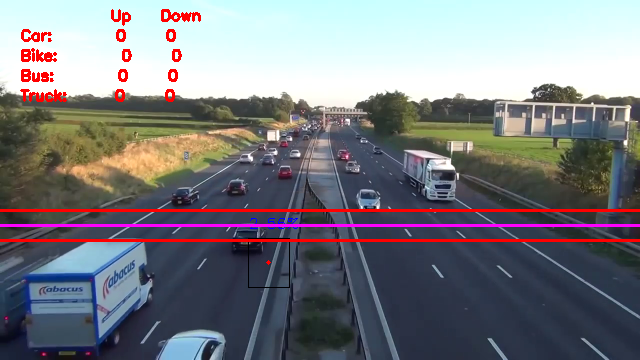

{'predictions': [{'x': 248.5, 'y': 238.5, 'width': 41, 'height': 49, 'class': '2', 'confidence': 0.568}]}


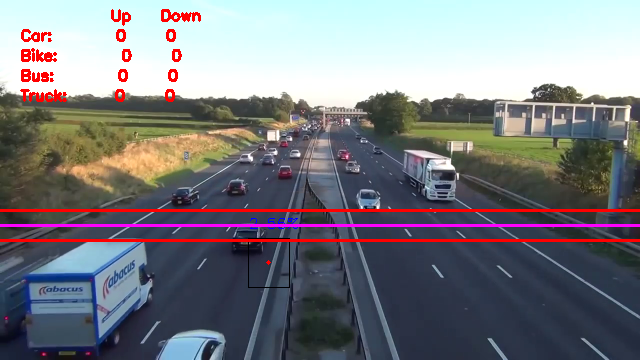

{'predictions': [{'x': 248.5, 'y': 237.0, 'width': 35, 'height': 50, 'class': '2', 'confidence': 0.603}]}


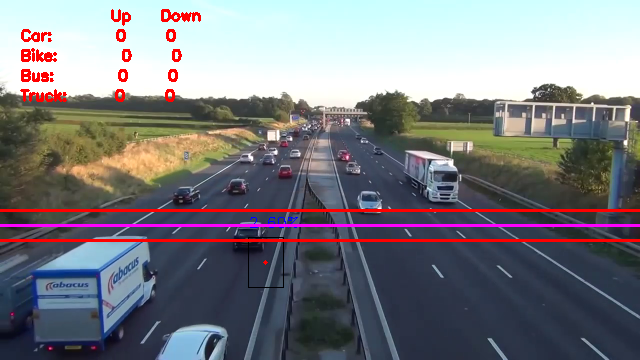

{'predictions': [{'x': 247.0, 'y': 234.0, 'width': 42, 'height': 46, 'class': '2', 'confidence': 0.48}]}


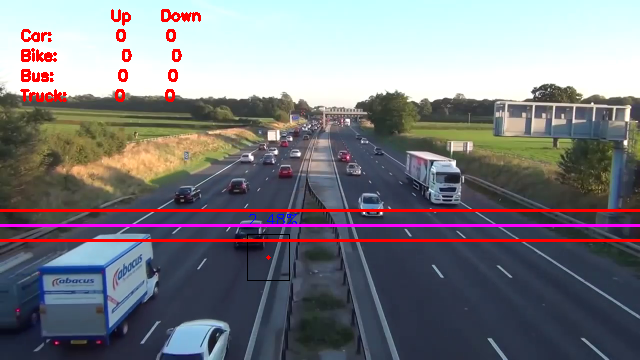

{'predictions': [{'x': 248.5, 'y': 231.5, 'width': 39, 'height': 47, 'class': '2', 'confidence': 0.51}, {'x': 438.5, 'y': 175.0, 'width': 49, 'height': 54, 'class': '4', 'confidence': 0.413}]}


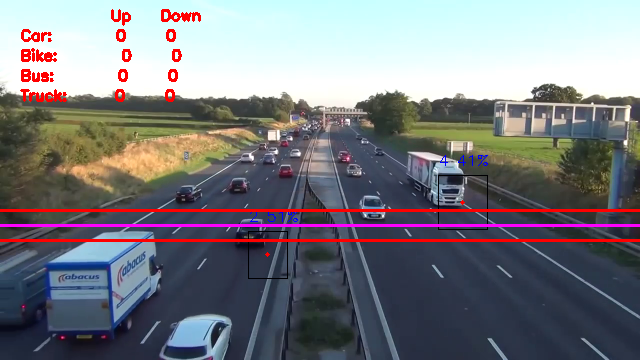

{'predictions': [{'x': 194.5, 'y': 336.0, 'width': 57, 'height': 48, 'class': '2', 'confidence': 0.445}, {'x': 107.5, 'y': 276.5, 'width': 95, 'height': 131, 'class': '1', 'confidence': 0.431}, {'x': 250.5, 'y': 229.5, 'width': 25, 'height': 49, 'class': '2', 'confidence': 0.423}, {'x': 377.0, 'y': 208.5, 'width': 28, 'height': 45, 'class': '2', 'confidence': 0.407}]}


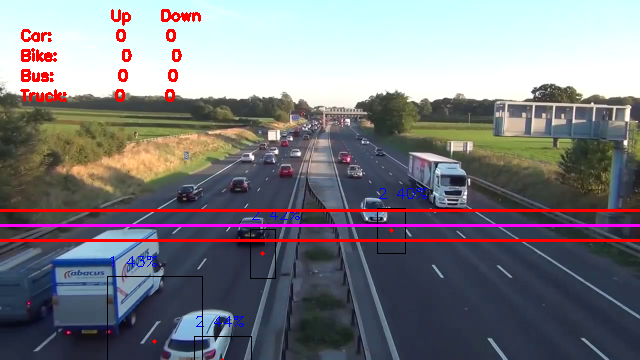

{'predictions': [{'x': 108.5, 'y': 276.0, 'width': 125, 'height': 116, 'class': '1', 'confidence': 0.473}, {'x': 202.5, 'y': 322.5, 'width': 75, 'height': 75, 'class': '2', 'confidence': 0.436}, {'x': 441.5, 'y': 176.5, 'width': 59, 'height': 63, 'class': '4', 'confidence': 0.417}, {'x': 377.5, 'y': 211.5, 'width': 23, 'height': 45, 'class': '2', 'confidence': 0.413}, {'x': 254.5, 'y': 227.5, 'width': 35, 'height': 49, 'class': '2', 'confidence': 0.407}]}


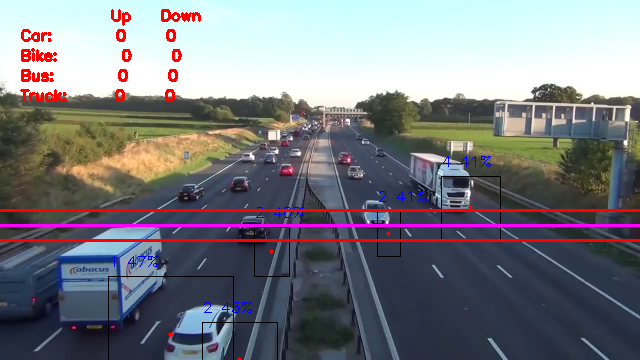

{'predictions': [{'x': 108.5, 'y': 276.0, 'width': 125, 'height': 116, 'class': '1', 'confidence': 0.468}, {'x': 202.5, 'y': 322.5, 'width': 75, 'height': 75, 'class': '2', 'confidence': 0.438}, {'x': 378.5, 'y': 211.5, 'width': 25, 'height': 45, 'class': '2', 'confidence': 0.432}, {'x': 441.5, 'y': 176.5, 'width': 59, 'height': 63, 'class': '4', 'confidence': 0.417}, {'x': 254.5, 'y': 227.5, 'width': 35, 'height': 49, 'class': '2', 'confidence': 0.406}]}


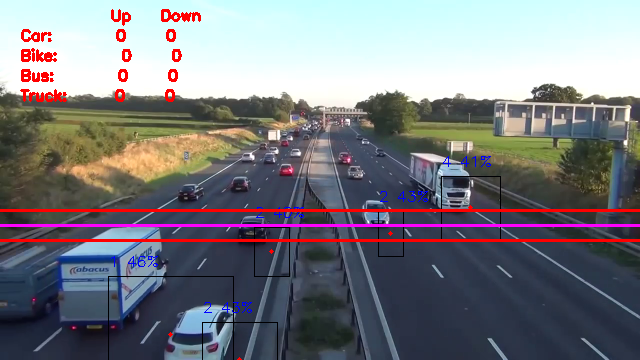

{'predictions': [{'x': 204.5, 'y': 324.0, 'width': 65, 'height': 72, 'class': '2', 'confidence': 0.496}, {'x': 255.5, 'y': 226.5, 'width': 31, 'height': 43, 'class': '2', 'confidence': 0.434}, {'x': 118.5, 'y': 271.0, 'width': 99, 'height': 126, 'class': '4', 'confidence': 0.423}, {'x': 442.0, 'y': 180.0, 'width': 60, 'height': 84, 'class': '1', 'confidence': 0.418}, {'x': 108.5, 'y': 276.0, 'width': 109, 'height': 112, 'class': '1', 'confidence': 0.409}]}


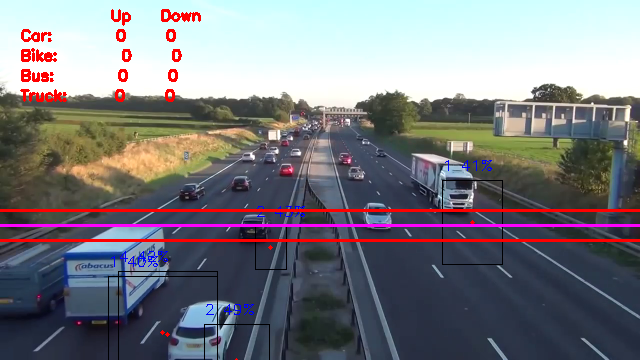

{'predictions': [{'x': 255.5, 'y': 224.0, 'width': 31, 'height': 42, 'class': '2', 'confidence': 0.514}, {'x': 120.0, 'y': 269.5, 'width': 104, 'height': 123, 'class': '4', 'confidence': 0.469}, {'x': 443.5, 'y': 185.0, 'width': 63, 'height': 80, 'class': '1', 'confidence': 0.46}, {'x': 113.0, 'y': 268.5, 'width': 106, 'height': 119, 'class': '1', 'confidence': 0.438}, {'x': 203.0, 'y': 327.0, 'width': 64, 'height': 66, 'class': '2', 'confidence': 0.428}]}


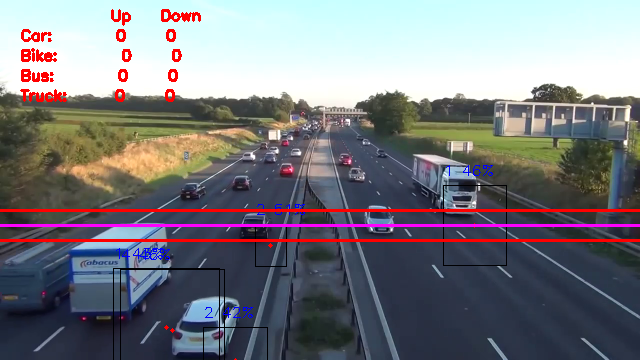

{'predictions': [{'x': 253.0, 'y': 221.0, 'width': 32, 'height': 48, 'class': '2', 'confidence': 0.459}, {'x': 125.5, 'y': 266.0, 'width': 121, 'height': 98, 'class': '4', 'confidence': 0.45}, {'x': 124.5, 'y': 262.5, 'width': 89, 'height': 91, 'class': '1', 'confidence': 0.444}, {'x': 206.5, 'y': 324.5, 'width': 57, 'height': 71, 'class': '2', 'confidence': 0.438}, {'x': 450.0, 'y': 182.5, 'width': 60, 'height': 91, 'class': '4', 'confidence': 0.429}, {'x': 382.0, 'y': 224.5, 'width': 26, 'height': 53, 'class': '2', 'confidence': 0.405}]}


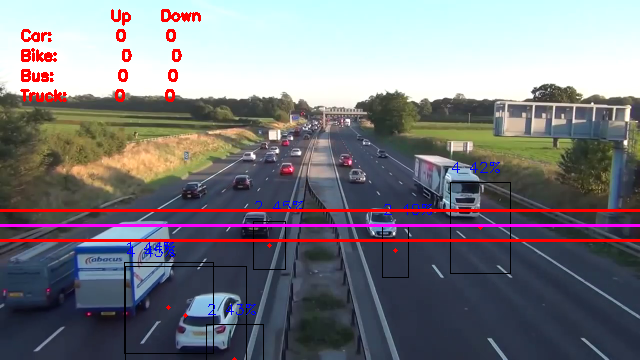

{'predictions': [{'x': 258.0, 'y': 220.5, 'width': 26, 'height': 45, 'class': '2', 'confidence': 0.647}, {'x': 449.0, 'y': 186.0, 'width': 68, 'height': 80, 'class': '1', 'confidence': 0.565}, {'x': 208.5, 'y': 321.5, 'width': 53, 'height': 71, 'class': '2', 'confidence': 0.498}, {'x': 129.5, 'y': 260.5, 'width': 89, 'height': 91, 'class': '1', 'confidence': 0.485}, {'x': 129.5, 'y': 262.5, 'width': 89, 'height': 115, 'class': '4', 'confidence': 0.409}]}


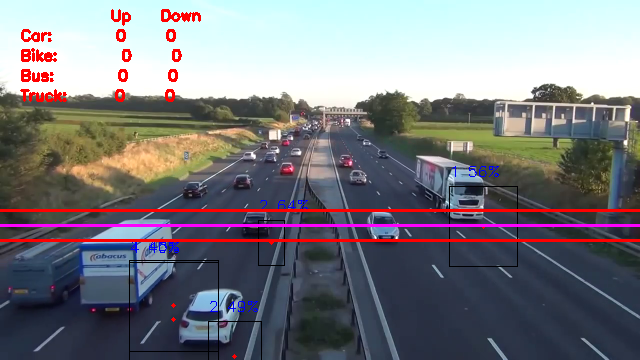

{'predictions': [{'x': 259.5, 'y': 219.0, 'width': 23, 'height': 48, 'class': '2', 'confidence': 0.602}, {'x': 211.0, 'y': 318.0, 'width': 58, 'height': 72, 'class': '2', 'confidence': 0.409}, {'x': 453.0, 'y': 187.0, 'width': 72, 'height': 82, 'class': '4', 'confidence': 0.404}, {'x': 126.0, 'y': 259.0, 'width': 86, 'height': 100, 'class': '4', 'confidence': 0.401}]}


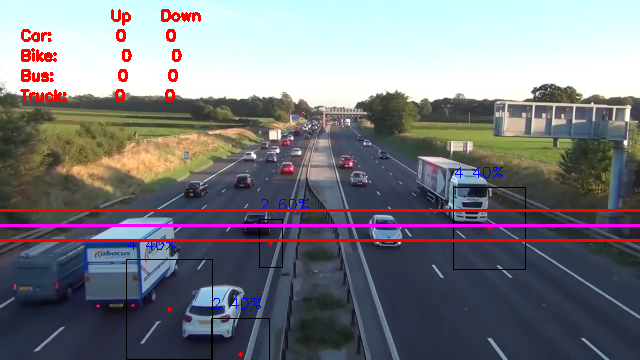

{'predictions': [{'x': 259.5, 'y': 219.0, 'width': 23, 'height': 48, 'class': '2', 'confidence': 0.612}, {'x': 129.5, 'y': 257.0, 'width': 105, 'height': 96, 'class': '4', 'confidence': 0.424}, {'x': 211.0, 'y': 318.0, 'width': 58, 'height': 72, 'class': '2', 'confidence': 0.405}, {'x': 452.0, 'y': 187.0, 'width': 74, 'height': 82, 'class': '4', 'confidence': 0.404}]}


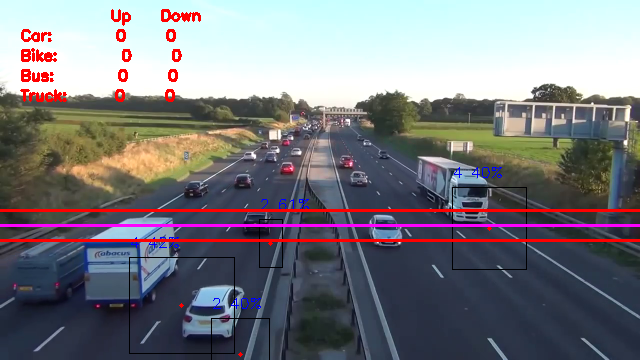

{'predictions': [{'x': 216.5, 'y': 303.5, 'width': 63, 'height': 83, 'class': '2', 'confidence': 0.706}, {'x': 259.0, 'y': 218.5, 'width': 26, 'height': 47, 'class': '2', 'confidence': 0.559}, {'x': 455.5, 'y': 190.0, 'width': 83, 'height': 76, 'class': '1', 'confidence': 0.485}, {'x': 129.0, 'y': 257.0, 'width': 86, 'height': 104, 'class': '4', 'confidence': 0.414}, {'x': 457.0, 'y': 187.0, 'width': 74, 'height': 84, 'class': '4', 'confidence': 0.411}]}


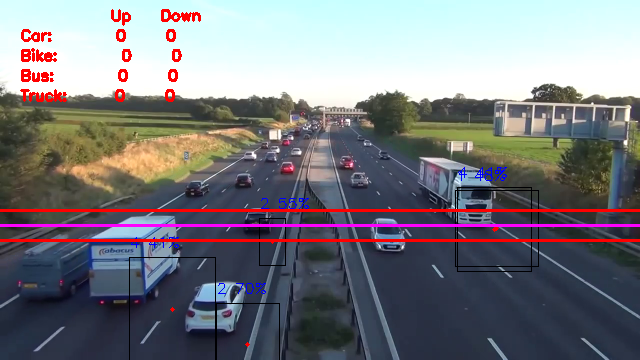

{'predictions': [{'x': 221.5, 'y': 300.0, 'width': 61, 'height': 86, 'class': '2', 'confidence': 0.619}, {'x': 261.0, 'y': 217.0, 'width': 26, 'height': 46, 'class': '2', 'confidence': 0.572}, {'x': 460.0, 'y': 191.0, 'width': 68, 'height': 92, 'class': '1', 'confidence': 0.414}, {'x': 133.0, 'y': 253.0, 'width': 100, 'height': 94, 'class': '4', 'confidence': 0.401}]}


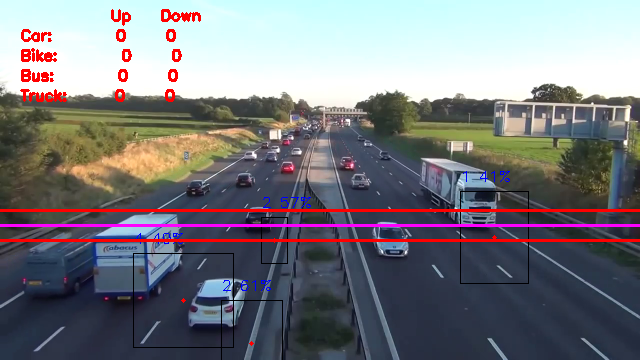

{'predictions': [{'x': 222.0, 'y': 295.0, 'width': 60, 'height': 86, 'class': '2', 'confidence': 0.591}, {'x': 261.0, 'y': 215.5, 'width': 26, 'height': 49, 'class': '2', 'confidence': 0.569}, {'x': 461.0, 'y': 191.5, 'width': 72, 'height': 97, 'class': '1', 'confidence': 0.466}, {'x': 136.5, 'y': 252.5, 'width': 83, 'height': 105, 'class': '4', 'confidence': 0.415}]}


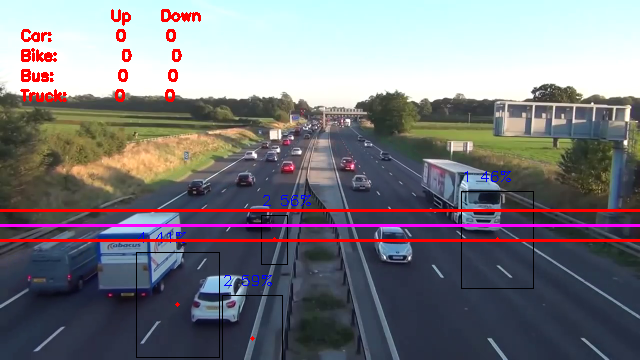

{'predictions': [{'x': 469.5, 'y': 197.5, 'width': 83, 'height': 85, 'class': '1', 'confidence': 0.619}, {'x': 260.5, 'y': 214.5, 'width': 29, 'height': 47, 'class': '2', 'confidence': 0.545}, {'x': 222.5, 'y': 290.0, 'width': 57, 'height': 88, 'class': '2', 'confidence': 0.52}, {'x': 464.0, 'y': 189.5, 'width': 100, 'height': 65, 'class': '4', 'confidence': 0.45}, {'x': 397.0, 'y': 246.5, 'width': 40, 'height': 57, 'class': '2', 'confidence': 0.417}, {'x': 141.0, 'y': 250.0, 'width': 82, 'height': 100, 'class': '4', 'confidence': 0.405}]}


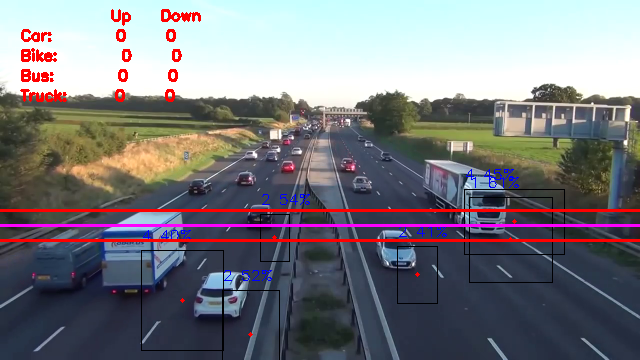

{'predictions': [{'x': 473.0, 'y': 200.5, 'width': 84, 'height': 97, 'class': '1', 'confidence': 0.56}, {'x': 260.5, 'y': 213.0, 'width': 29, 'height': 48, 'class': '2', 'confidence': 0.527}, {'x': 469.5, 'y': 197.0, 'width': 77, 'height': 110, 'class': '4', 'confidence': 0.48}, {'x': 400.0, 'y': 252.5, 'width': 40, 'height': 59, 'class': '2', 'confidence': 0.439}, {'x': 224.5, 'y': 292.5, 'width': 53, 'height': 65, 'class': '2', 'confidence': 0.407}]}


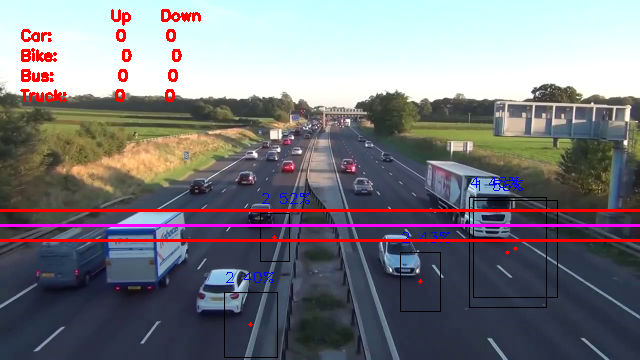

{'predictions': [{'x': 473.0, 'y': 201.5, 'width': 84, 'height': 95, 'class': '1', 'confidence': 0.567}, {'x': 260.5, 'y': 213.0, 'width': 29, 'height': 48, 'class': '2', 'confidence': 0.525}, {'x': 469.5, 'y': 197.0, 'width': 77, 'height': 110, 'class': '4', 'confidence': 0.483}, {'x': 400.0, 'y': 252.5, 'width': 40, 'height': 59, 'class': '2', 'confidence': 0.433}, {'x': 224.5, 'y': 292.5, 'width': 53, 'height': 65, 'class': '2', 'confidence': 0.406}]}


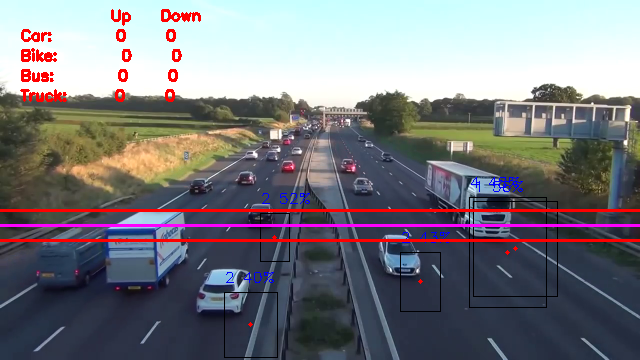

{'predictions': [{'x': 474.0, 'y': 204.0, 'width': 92, 'height': 94, 'class': '1', 'confidence': 0.685}, {'x': 261.5, 'y': 211.5, 'width': 27, 'height': 47, 'class': '2', 'confidence': 0.513}, {'x': 400.0, 'y': 259.5, 'width': 36, 'height': 75, 'class': '2', 'confidence': 0.504}, {'x': 476.0, 'y': 198.5, 'width': 94, 'height': 113, 'class': '4', 'confidence': 0.467}, {'x': 147.0, 'y': 245.0, 'width': 100, 'height': 100, 'class': '4', 'confidence': 0.404}, {'x': 226.5, 'y': 299.0, 'width': 49, 'height': 60, 'class': '2', 'confidence': 0.402}]}


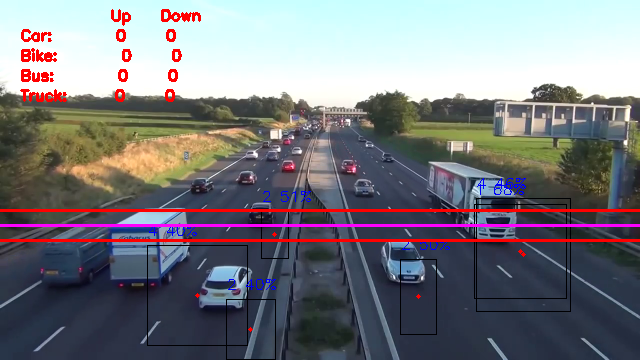

{'predictions': [{'x': 477.0, 'y': 204.5, 'width': 98, 'height': 95, 'class': '1', 'confidence': 0.636}, {'x': 480.5, 'y': 198.5, 'width': 97, 'height': 95, 'class': '4', 'confidence': 0.509}, {'x': 224.5, 'y': 284.0, 'width': 49, 'height': 66, 'class': '2', 'confidence': 0.477}]}


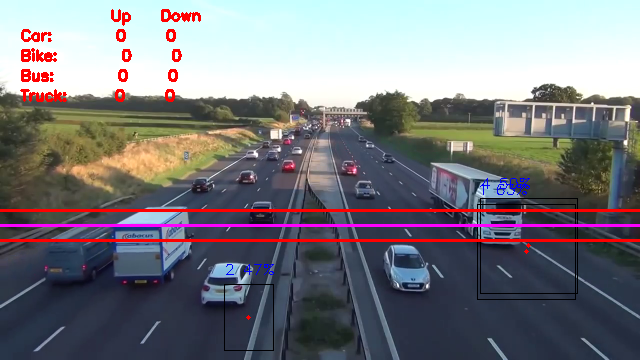

{'predictions': [{'x': 417.0, 'y': 271.5, 'width': 62, 'height': 91, 'class': '2', 'confidence': 0.559}, {'x': 485.0, 'y': 202.0, 'width': 100, 'height': 120, 'class': '4', 'confidence': 0.505}, {'x': 147.5, 'y': 237.0, 'width': 65, 'height': 102, 'class': '4', 'confidence': 0.501}, {'x': 481.5, 'y': 207.5, 'width': 99, 'height': 101, 'class': '1', 'confidence': 0.454}, {'x': 228.5, 'y': 293.5, 'width': 47, 'height': 57, 'class': '2', 'confidence': 0.434}]}


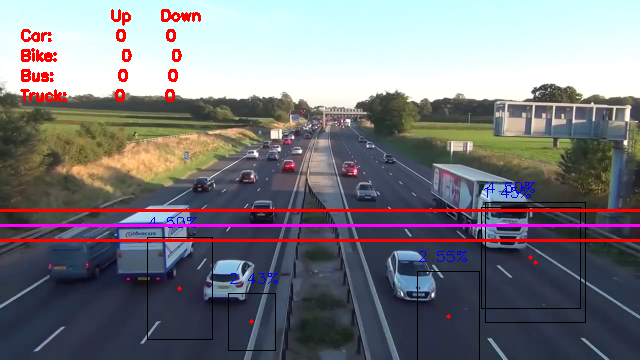

{'predictions': [{'x': 491.0, 'y': 204.0, 'width': 120, 'height': 124, 'class': '1', 'confidence': 0.564}, {'x': 233.5, 'y': 273.5, 'width': 57, 'height': 71, 'class': '2', 'confidence': 0.547}, {'x': 490.0, 'y': 201.5, 'width': 104, 'height': 127, 'class': '4', 'confidence': 0.458}, {'x': 418.5, 'y': 280.5, 'width': 55, 'height': 91, 'class': '2', 'confidence': 0.418}]}


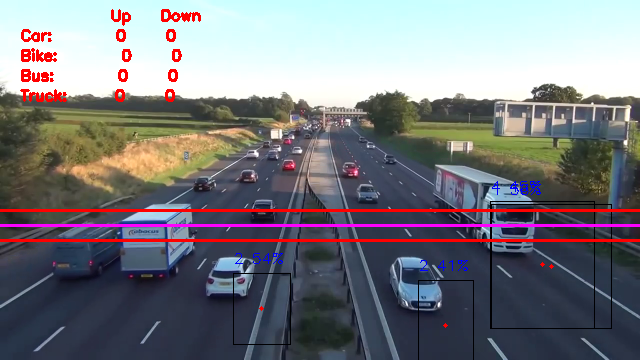

{'predictions': [{'x': 487.5, 'y': 209.5, 'width': 89, 'height': 117, 'class': '1', 'confidence': 0.511}, {'x': 491.0, 'y': 203.0, 'width': 98, 'height': 126, 'class': '4', 'confidence': 0.469}, {'x': 230.0, 'y': 274.5, 'width': 32, 'height': 73, 'class': '2', 'confidence': 0.468}, {'x': 424.0, 'y': 287.0, 'width': 60, 'height': 90, 'class': '1', 'confidence': 0.46}, {'x': 424.5, 'y': 294.5, 'width': 77, 'height': 81, 'class': '2', 'confidence': 0.453}]}


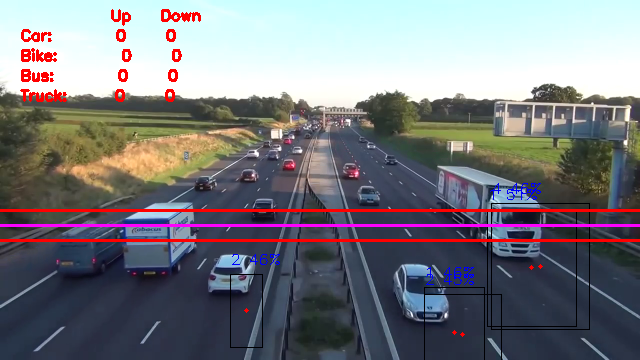

{'predictions': [{'x': 487.5, 'y': 208.5, 'width': 89, 'height': 119, 'class': '1', 'confidence': 0.515}, {'x': 491.0, 'y': 203.0, 'width': 98, 'height': 126, 'class': '4', 'confidence': 0.474}, {'x': 230.0, 'y': 274.5, 'width': 32, 'height': 73, 'class': '2', 'confidence': 0.465}, {'x': 424.0, 'y': 287.0, 'width': 60, 'height': 90, 'class': '1', 'confidence': 0.457}, {'x': 424.5, 'y': 294.5, 'width': 77, 'height': 81, 'class': '2', 'confidence': 0.447}]}


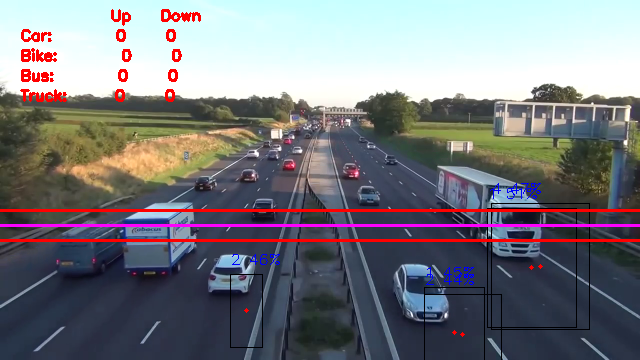

{'predictions': [{'x': 234.5, 'y': 266.0, 'width': 51, 'height': 68, 'class': '2', 'confidence': 0.538}, {'x': 155.5, 'y': 235.0, 'width': 53, 'height': 100, 'class': '2', 'confidence': 0.523}, {'x': 493.0, 'y': 208.5, 'width': 118, 'height': 125, 'class': '1', 'confidence': 0.458}, {'x': 430.5, 'y': 298.5, 'width': 49, 'height': 95, 'class': '1', 'confidence': 0.42}, {'x': 493.5, 'y': 210.0, 'width': 111, 'height': 116, 'class': '4', 'confidence': 0.411}]}


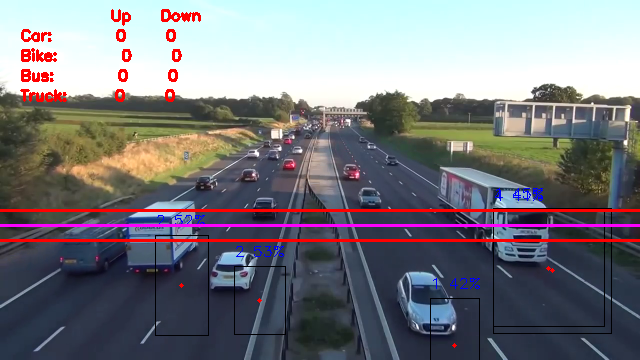

{'predictions': [{'x': 496.0, 'y': 217.0, 'width': 124, 'height': 108, 'class': '1', 'confidence': 0.612}, {'x': 499.0, 'y': 213.0, 'width': 122, 'height': 122, 'class': '4', 'confidence': 0.49}, {'x': 155.5, 'y': 235.0, 'width': 53, 'height': 100, 'class': '2', 'confidence': 0.482}, {'x': 441.5, 'y': 308.5, 'width': 73, 'height': 103, 'class': '2', 'confidence': 0.432}, {'x': 437.5, 'y': 313.0, 'width': 69, 'height': 82, 'class': '1', 'confidence': 0.421}, {'x': 235.5, 'y': 266.0, 'width': 49, 'height': 62, 'class': '2', 'confidence': 0.419}]}


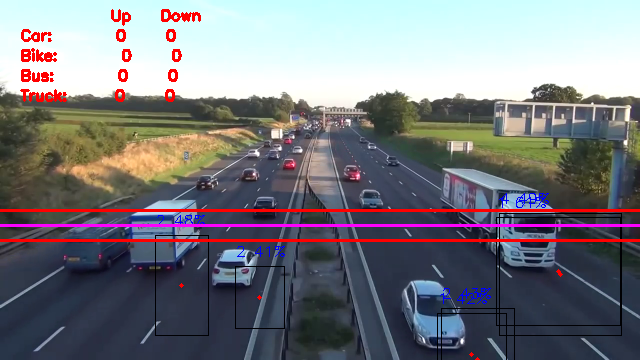

{'predictions': [{'x': 440.5, 'y': 318.5, 'width': 75, 'height': 83, 'class': '1', 'confidence': 0.51}, {'x': 157.5, 'y': 235.0, 'width': 51, 'height': 100, 'class': '2', 'confidence': 0.456}, {'x': 443.0, 'y': 314.0, 'width': 64, 'height': 92, 'class': '2', 'confidence': 0.452}, {'x': 506.0, 'y': 219.0, 'width': 138, 'height': 146, 'class': '4', 'confidence': 0.424}, {'x': 236.0, 'y': 264.5, 'width': 54, 'height': 71, 'class': '2', 'confidence': 0.414}]}


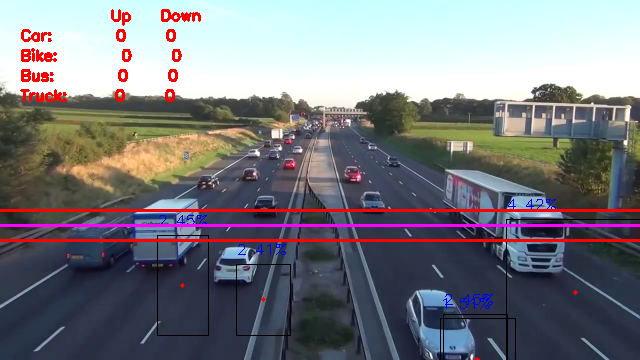

{'predictions': [{'x': 510.0, 'y': 223.5, 'width': 134, 'height': 143, 'class': '1', 'confidence': 0.595}, {'x': 237.0, 'y': 263.5, 'width': 40, 'height': 77, 'class': '2', 'confidence': 0.502}]}


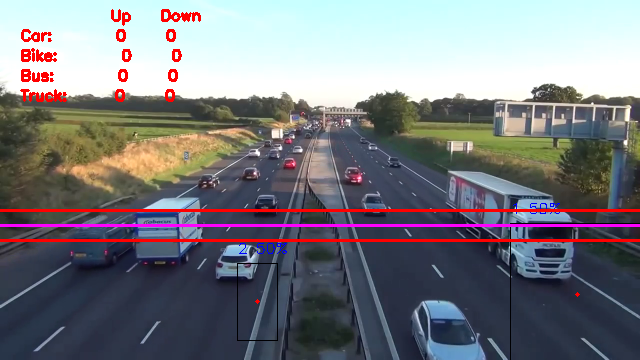

{'predictions': [{'x': 237.0, 'y': 261.5, 'width': 40, 'height': 71, 'class': '2', 'confidence': 0.528}, {'x': 521.5, 'y': 230.0, 'width': 141, 'height': 134, 'class': '1', 'confidence': 0.424}]}


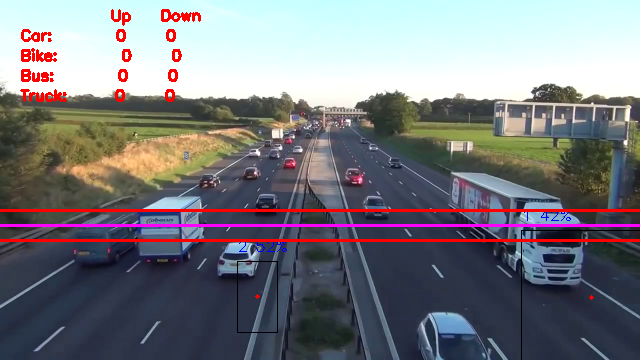

{'predictions': [{'x': 237.0, 'y': 261.5, 'width': 40, 'height': 71, 'class': '2', 'confidence': 0.53}, {'x': 517.5, 'y': 230.0, 'width': 137, 'height': 134, 'class': '1', 'confidence': 0.52}]}


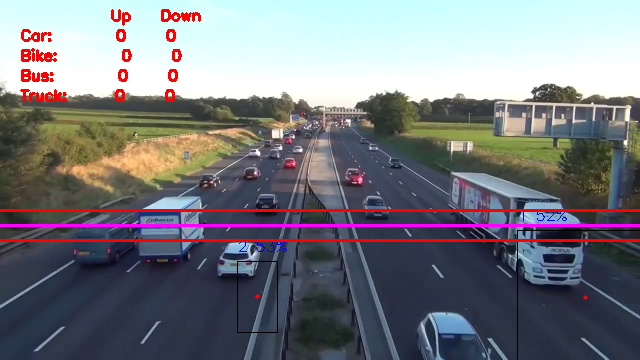

{'predictions': [{'x': 524.0, 'y': 234.0, 'width': 146, 'height': 142, 'class': '1', 'confidence': 0.621}, {'x': 240.0, 'y': 258.5, 'width': 36, 'height': 53, 'class': '2', 'confidence': 0.572}, {'x': 380.5, 'y': 210.0, 'width': 23, 'height': 42, 'class': '2', 'confidence': 0.545}]}


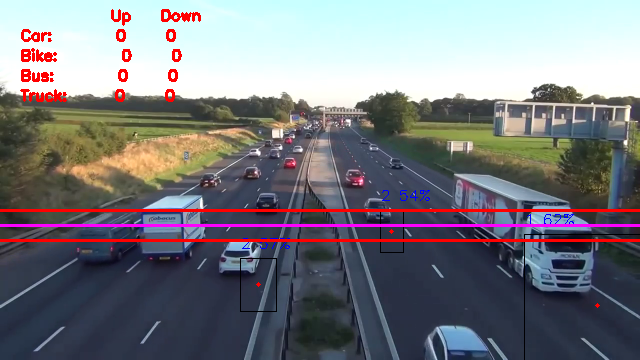

{'predictions': [{'x': 535.5, 'y': 237.0, 'width': 175, 'height': 144, 'class': '1', 'confidence': 0.66}, {'x': 240.0, 'y': 257.0, 'width': 36, 'height': 56, 'class': '2', 'confidence': 0.518}, {'x': 382.0, 'y': 211.5, 'width': 26, 'height': 45, 'class': '2', 'confidence': 0.463}]}


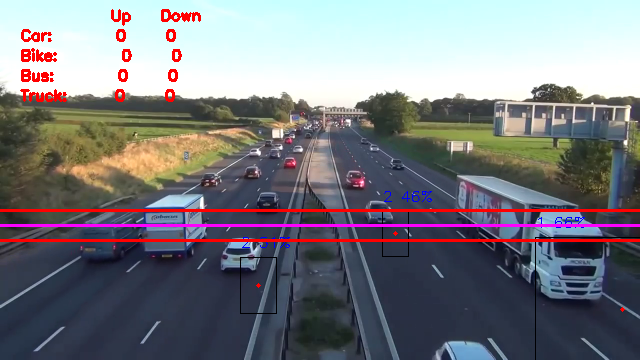

{'predictions': [{'x': 541.0, 'y': 241.0, 'width': 180, 'height': 152, 'class': '1', 'confidence': 0.705}, {'x': 536.0, 'y': 243.0, 'width': 164, 'height': 148, 'class': '4', 'confidence': 0.577}, {'x': 383.0, 'y': 215.5, 'width': 22, 'height': 49, 'class': '2', 'confidence': 0.472}]}


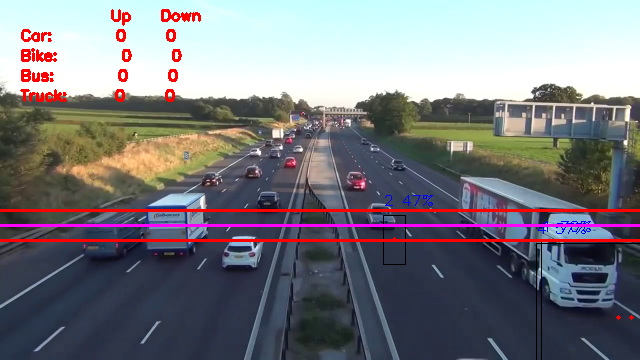

{'predictions': [{'x': 383.5, 'y': 220.5, 'width': 23, 'height': 51, 'class': '2', 'confidence': 0.526}, {'x': 543.0, 'y': 245.0, 'width': 182, 'height': 160, 'class': '1', 'confidence': 0.433}]}


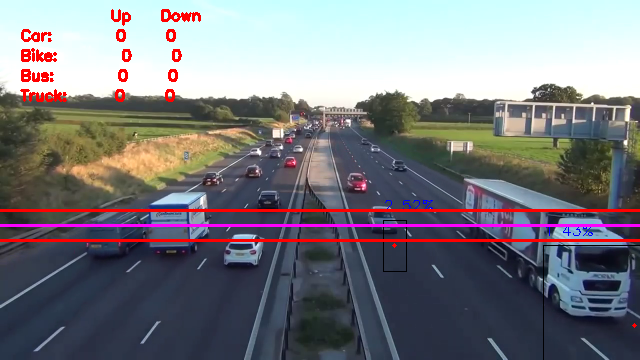

{'predictions': [{'x': 548.0, 'y': 248.5, 'width': 180, 'height': 173, 'class': '4', 'confidence': 0.632}, {'x': 384.5, 'y': 224.5, 'width': 27, 'height': 59, 'class': '2', 'confidence': 0.467}, {'x': 541.5, 'y': 249.5, 'width': 169, 'height': 157, 'class': '1', 'confidence': 0.424}]}


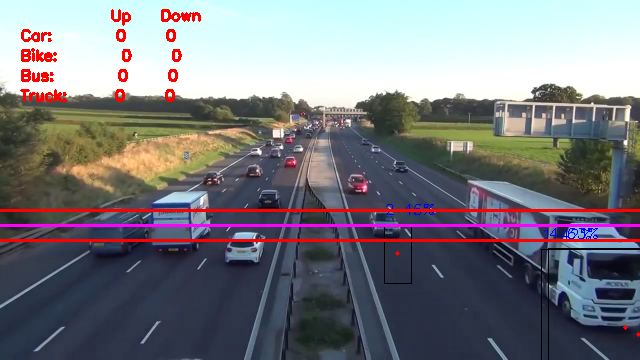

{'predictions': [{'x': 547.5, 'y': 248.5, 'width': 181, 'height': 173, 'class': '4', 'confidence': 0.626}, {'x': 384.5, 'y': 224.5, 'width': 27, 'height': 59, 'class': '2', 'confidence': 0.462}, {'x': 541.5, 'y': 249.0, 'width': 169, 'height': 160, 'class': '1', 'confidence': 0.416}]}


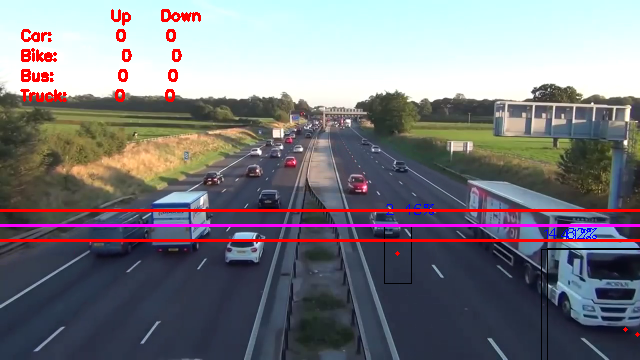

{'predictions': [{'x': 547.5, 'y': 255.0, 'width': 181, 'height': 180, 'class': '1', 'confidence': 0.569}]}


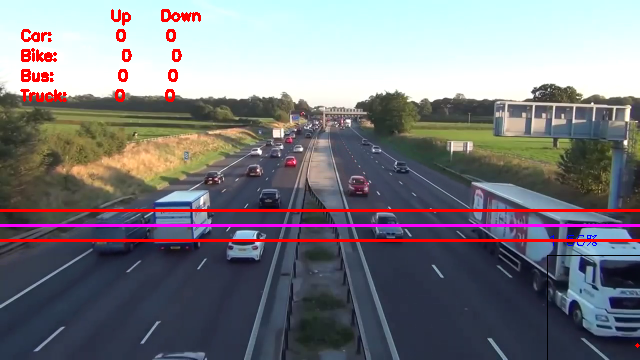

{'predictions': [{'x': 359.5, 'y': 186.5, 'width': 23, 'height': 37, 'class': '2', 'confidence': 0.401}]}


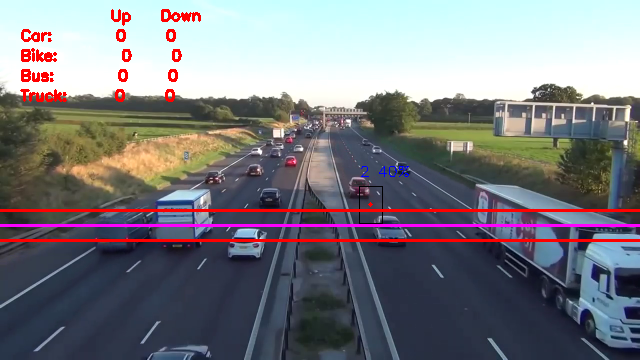

{'predictions': [{'x': 394.5, 'y': 234.5, 'width': 33, 'height': 57, 'class': '2', 'confidence': 0.41}]}


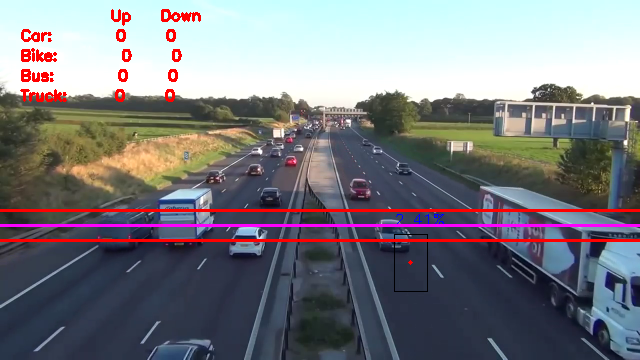

{'predictions': [{'x': 394.5, 'y': 238.5, 'width': 39, 'height': 49, 'class': '2', 'confidence': 0.449}, {'x': 247.0, 'y': 237.5, 'width': 42, 'height': 45, 'class': '2', 'confidence': 0.427}]}


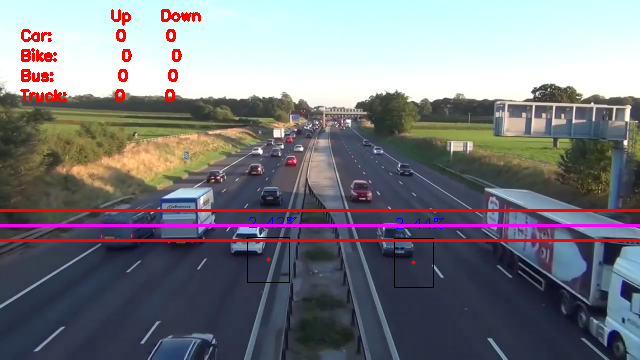

{'predictions': [{'x': 247.0, 'y': 236.0, 'width': 42, 'height': 48, 'class': '2', 'confidence': 0.486}, {'x': 398.5, 'y': 247.0, 'width': 31, 'height': 54, 'class': '2', 'confidence': 0.462}]}


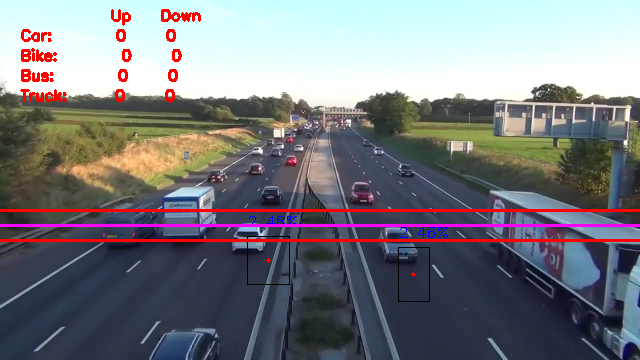

{'predictions': [{'x': 247.0, 'y': 236.0, 'width': 42, 'height': 48, 'class': '2', 'confidence': 0.494}, {'x': 398.5, 'y': 247.0, 'width': 31, 'height': 54, 'class': '2', 'confidence': 0.463}]}


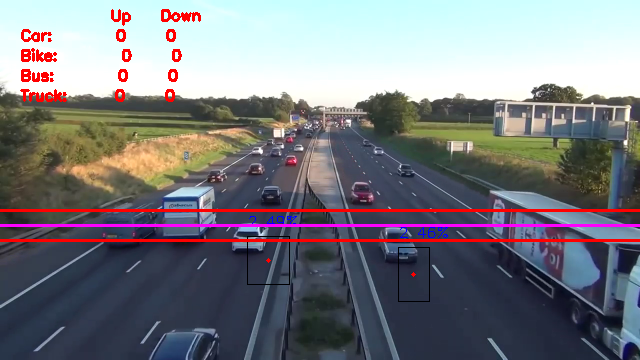

{'predictions': [{'x': 400.0, 'y': 249.0, 'width': 34, 'height': 58, 'class': '2', 'confidence': 0.502}, {'x': 248.0, 'y': 233.0, 'width': 40, 'height': 44, 'class': '2', 'confidence': 0.487}, {'x': 559.0, 'y': 268.5, 'width': 162, 'height': 171, 'class': '1', 'confidence': 0.413}]}


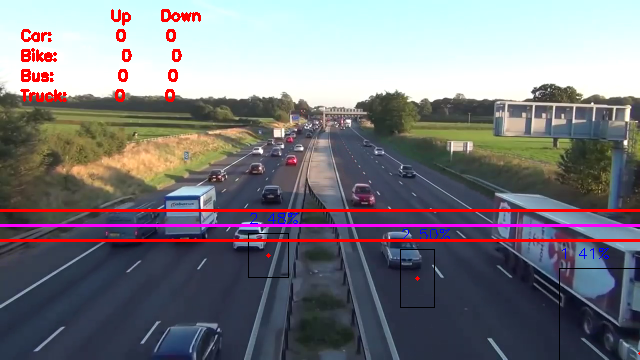

{'predictions': [{'x': 248.5, 'y': 233.0, 'width': 41, 'height': 44, 'class': '2', 'confidence': 0.514}, {'x': 367.0, 'y': 196.5, 'width': 20, 'height': 37, 'class': '2', 'confidence': 0.465}, {'x': 407.0, 'y': 255.0, 'width': 44, 'height': 66, 'class': '2', 'confidence': 0.423}]}


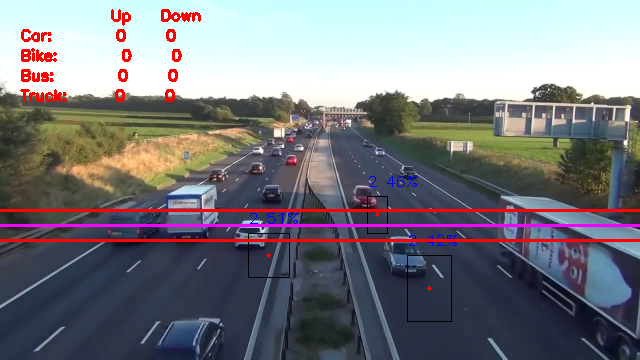

{'predictions': [{'x': 408.5, 'y': 260.0, 'width': 45, 'height': 68, 'class': '2', 'confidence': 0.515}, {'x': 251.5, 'y': 231.5, 'width': 39, 'height': 45, 'class': '2', 'confidence': 0.437}, {'x': 368.0, 'y': 201.5, 'width': 20, 'height': 33, 'class': '2', 'confidence': 0.432}, {'x': 182.5, 'y': 338.5, 'width': 63, 'height': 43, 'class': '2', 'confidence': 0.422}]}


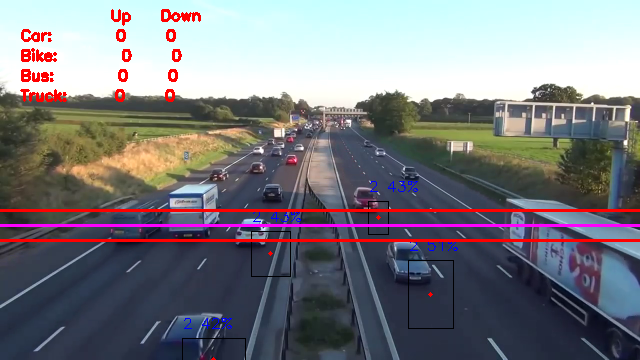

{'predictions': [{'x': 411.5, 'y': 278.5, 'width': 51, 'height': 67, 'class': '2', 'confidence': 0.423}, {'x': 369.0, 'y': 204.0, 'width': 22, 'height': 36, 'class': '2', 'confidence': 0.406}, {'x': 183.5, 'y': 331.0, 'width': 77, 'height': 58, 'class': '2', 'confidence': 0.402}]}


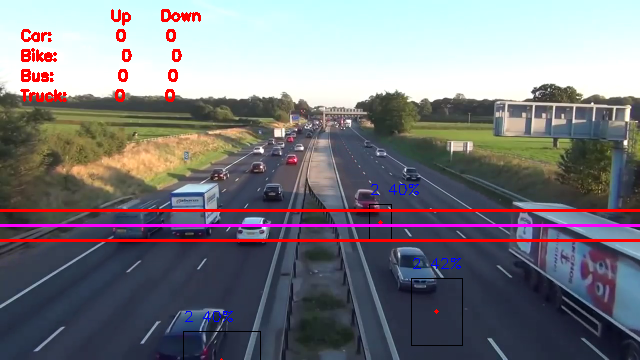

{'predictions': [{'x': 420.0, 'y': 272.5, 'width': 58, 'height': 95, 'class': '2', 'confidence': 0.488}, {'x': 194.5, 'y': 322.5, 'width': 75, 'height': 75, 'class': '2', 'confidence': 0.473}, {'x': 371.5, 'y': 207.0, 'width': 29, 'height': 30, 'class': '2', 'confidence': 0.426}]}


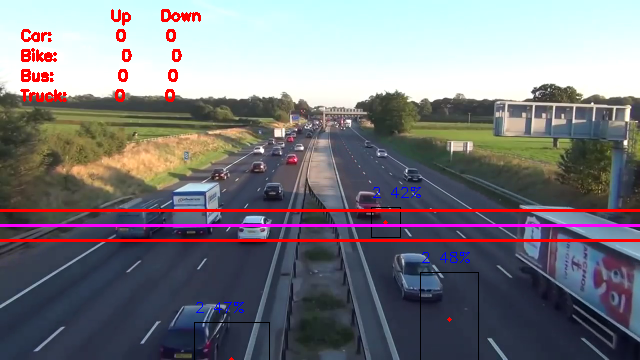

{'predictions': [{'x': 420.0, 'y': 272.5, 'width': 58, 'height': 95, 'class': '2', 'confidence': 0.486}, {'x': 194.5, 'y': 322.5, 'width': 75, 'height': 75, 'class': '2', 'confidence': 0.47}, {'x': 371.5, 'y': 207.5, 'width': 29, 'height': 31, 'class': '2', 'confidence': 0.424}]}


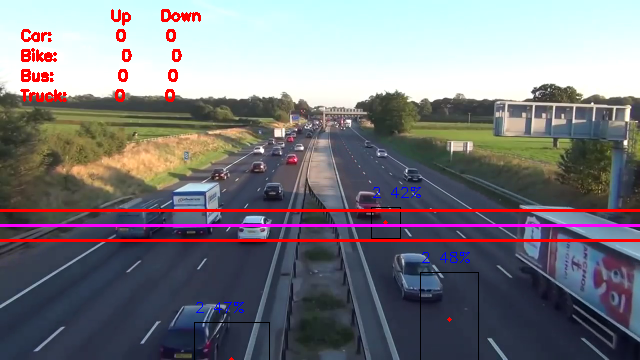

{'predictions': [{'x': 194.5, 'y': 318.5, 'width': 73, 'height': 83, 'class': '2', 'confidence': 0.594}, {'x': 371.5, 'y': 210.5, 'width': 27, 'height': 43, 'class': '2', 'confidence': 0.567}, {'x': 416.5, 'y': 288.5, 'width': 37, 'height': 87, 'class': '2', 'confidence': 0.469}, {'x': 257.5, 'y': 226.5, 'width': 35, 'height': 37, 'class': '2', 'confidence': 0.422}]}


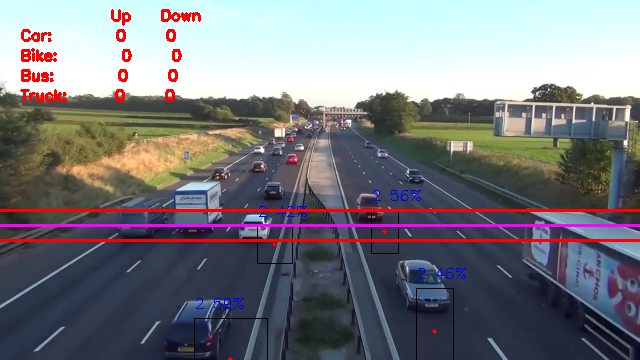

{'predictions': [{'x': 371.5, 'y': 213.0, 'width': 29, 'height': 48, 'class': '2', 'confidence': 0.57}, {'x': 430.0, 'y': 291.0, 'width': 56, 'height': 86, 'class': '1', 'confidence': 0.505}, {'x': 197.0, 'y': 317.0, 'width': 68, 'height': 86, 'class': '2', 'confidence': 0.483}, {'x': 426.0, 'y': 300.5, 'width': 52, 'height': 85, 'class': '2', 'confidence': 0.461}]}


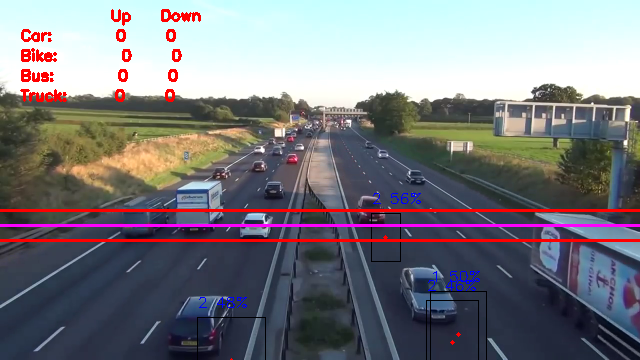

{'predictions': [{'x': 437.5, 'y': 302.5, 'width': 57, 'height': 91, 'class': '2', 'confidence': 0.428}, {'x': 196.0, 'y': 321.5, 'width': 54, 'height': 77, 'class': '2', 'confidence': 0.425}, {'x': 371.5, 'y': 215.0, 'width': 33, 'height': 60, 'class': '2', 'confidence': 0.419}]}


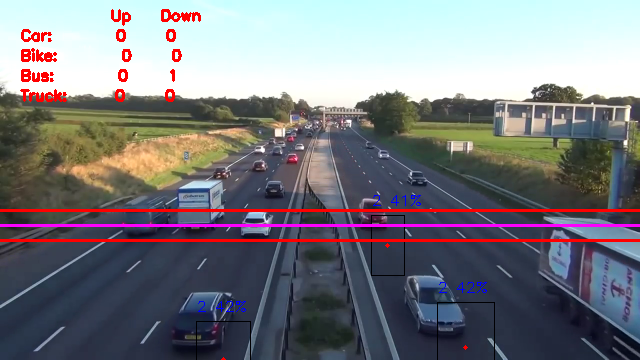

{'predictions': [{'x': 375.0, 'y': 218.0, 'width': 46, 'height': 60, 'class': '2', 'confidence': 0.645}, {'x': 443.0, 'y': 308.5, 'width': 68, 'height': 103, 'class': '2', 'confidence': 0.566}, {'x': 444.5, 'y': 313.0, 'width': 65, 'height': 88, 'class': '1', 'confidence': 0.435}, {'x': 199.0, 'y': 320.0, 'width': 54, 'height': 80, 'class': '2', 'confidence': 0.426}]}


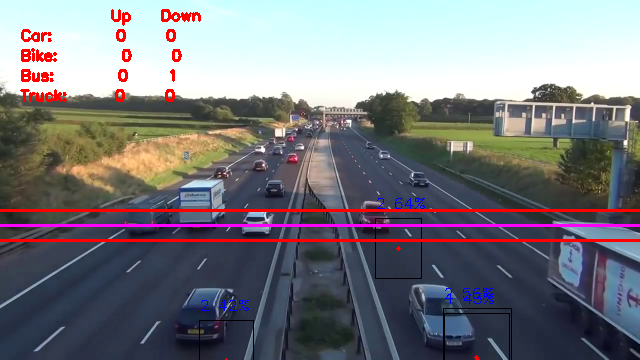

{'predictions': [{'x': 448.5, 'y': 316.0, 'width': 73, 'height': 88, 'class': '1', 'confidence': 0.623}, {'x': 376.5, 'y': 221.5, 'width': 23, 'height': 53, 'class': '2', 'confidence': 0.516}, {'x': 447.5, 'y': 320.0, 'width': 71, 'height': 74, 'class': '2', 'confidence': 0.448}, {'x': 200.5, 'y': 316.5, 'width': 51, 'height': 77, 'class': '2', 'confidence': 0.444}]}


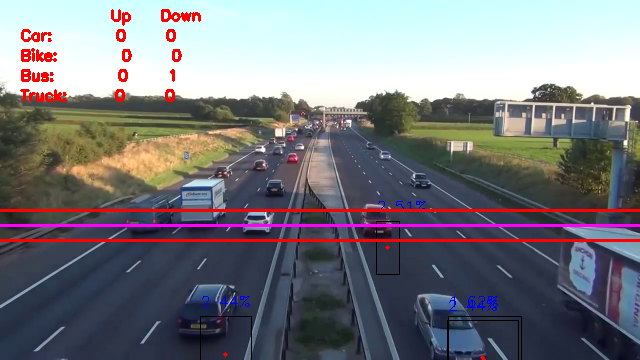

{'predictions': [{'x': 448.5, 'y': 316.0, 'width': 73, 'height': 88, 'class': '1', 'confidence': 0.621}, {'x': 376.5, 'y': 221.5, 'width': 23, 'height': 53, 'class': '2', 'confidence': 0.516}, {'x': 447.5, 'y': 320.0, 'width': 71, 'height': 74, 'class': '2', 'confidence': 0.448}, {'x': 200.5, 'y': 316.5, 'width': 51, 'height': 77, 'class': '2', 'confidence': 0.445}]}


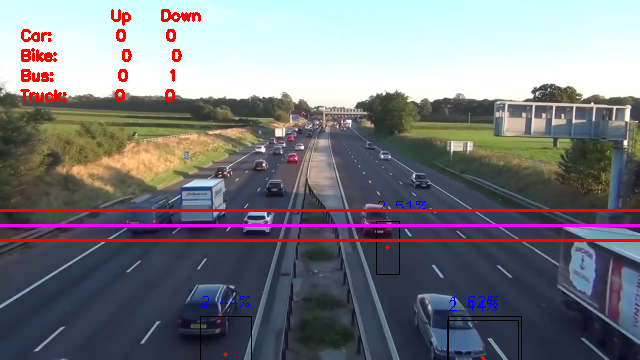

{'predictions': [{'x': 381.5, 'y': 225.0, 'width': 37, 'height': 54, 'class': '2', 'confidence': 0.603}, {'x': 455.0, 'y': 321.5, 'width': 80, 'height': 77, 'class': '2', 'confidence': 0.518}, {'x': 258.5, 'y': 216.5, 'width': 25, 'height': 43, 'class': '2', 'confidence': 0.41}, {'x': 204.0, 'y': 315.5, 'width': 48, 'height': 77, 'class': '2', 'confidence': 0.407}]}


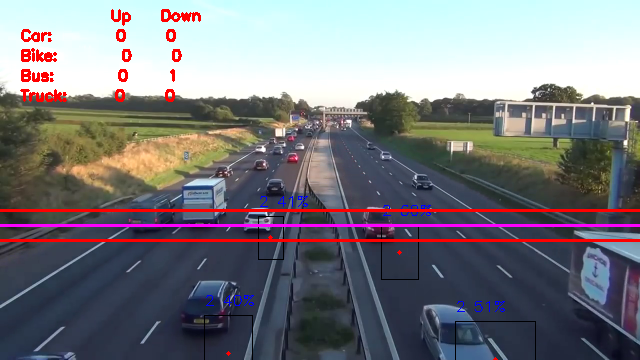

{'predictions': [{'x': 382.5, 'y': 227.0, 'width': 41, 'height': 66, 'class': '2', 'confidence': 0.52}, {'x': 210.0, 'y': 299.5, 'width': 60, 'height': 85, 'class': '2', 'confidence': 0.419}, {'x': 459.0, 'y': 337.0, 'width': 66, 'height': 46, 'class': '2', 'confidence': 0.411}]}


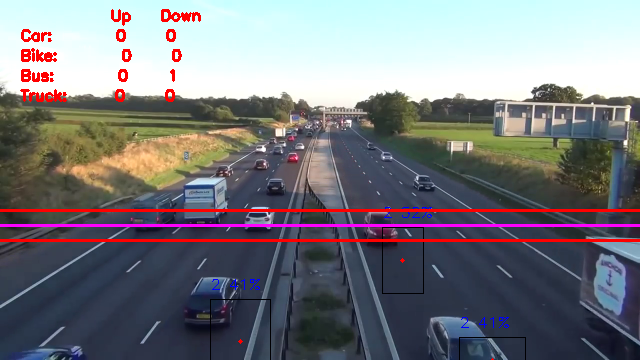

{'predictions': [{'x': 209.0, 'y': 296.0, 'width': 46, 'height': 76, 'class': '2', 'confidence': 0.578}, {'x': 380.5, 'y': 231.5, 'width': 45, 'height': 53, 'class': '2', 'confidence': 0.46}, {'x': 261.0, 'y': 215.5, 'width': 26, 'height': 43, 'class': '2', 'confidence': 0.452}]}


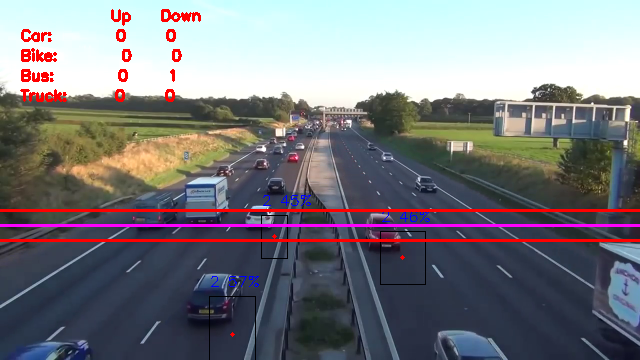

{'predictions': [{'x': 213.0, 'y': 292.5, 'width': 44, 'height': 77, 'class': '2', 'confidence': 0.683}, {'x': 384.0, 'y': 237.0, 'width': 42, 'height': 70, 'class': '2', 'confidence': 0.404}]}


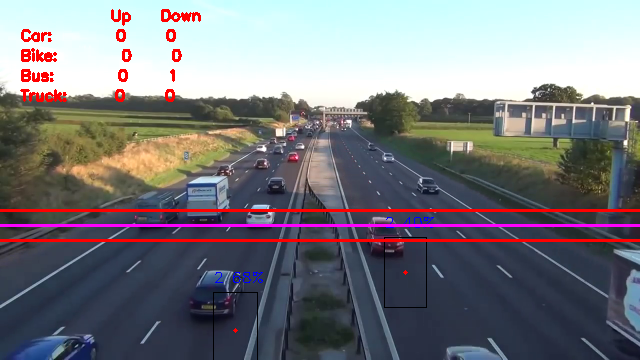

{'predictions': [{'x': 213.0, 'y': 289.5, 'width': 44, 'height': 77, 'class': '2', 'confidence': 0.634}, {'x': 387.5, 'y': 241.5, 'width': 49, 'height': 65, 'class': '2', 'confidence': 0.495}, {'x': 261.0, 'y': 215.5, 'width': 26, 'height': 43, 'class': '2', 'confidence': 0.478}]}


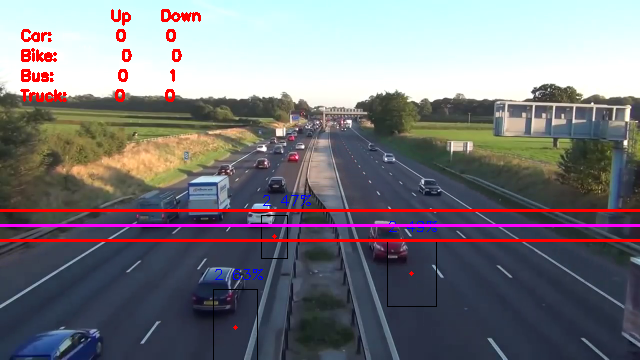

{'predictions': [{'x': 213.0, 'y': 289.5, 'width': 44, 'height': 77, 'class': '2', 'confidence': 0.636}, {'x': 261.0, 'y': 215.5, 'width': 26, 'height': 43, 'class': '2', 'confidence': 0.496}, {'x': 387.5, 'y': 241.5, 'width': 49, 'height': 65, 'class': '2', 'confidence': 0.477}]}


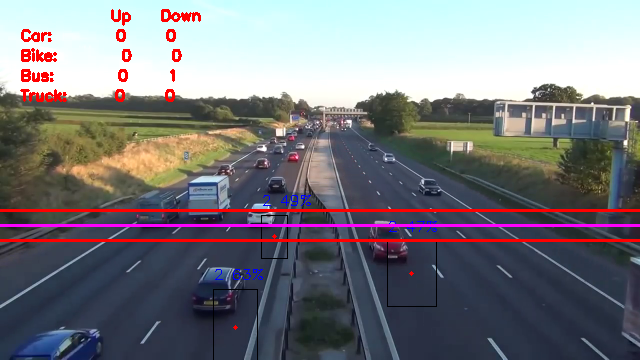

{'predictions': [{'x': 221.5, 'y': 284.0, 'width': 61, 'height': 82, 'class': '2', 'confidence': 0.643}, {'x': 389.0, 'y': 250.0, 'width': 40, 'height': 60, 'class': '2', 'confidence': 0.468}, {'x': 52.0, 'y': 339.0, 'width': 80, 'height': 42, 'class': '2', 'confidence': 0.44}]}


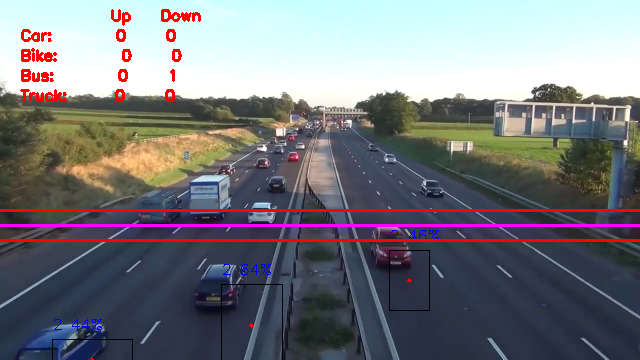

{'predictions': [{'x': 223.0, 'y': 281.5, 'width': 58, 'height': 87, 'class': '2', 'confidence': 0.645}, {'x': 394.5, 'y': 249.0, 'width': 47, 'height': 80, 'class': '2', 'confidence': 0.544}, {'x': 60.0, 'y': 337.0, 'width': 80, 'height': 46, 'class': '2', 'confidence': 0.542}]}


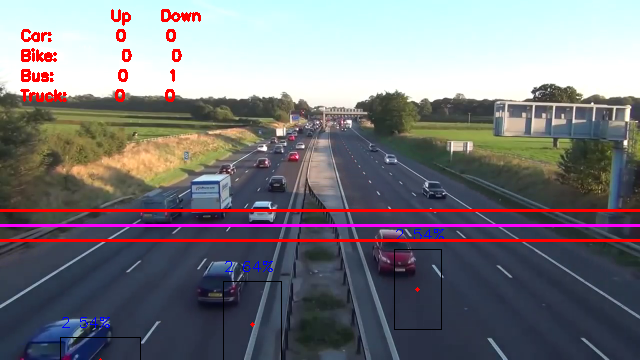

{'predictions': [{'x': 65.5, 'y': 334.0, 'width': 81, 'height': 52, 'class': '2', 'confidence': 0.569}, {'x': 223.5, 'y': 278.5, 'width': 57, 'height': 73, 'class': '2', 'confidence': 0.509}, {'x': 397.0, 'y': 258.5, 'width': 56, 'height': 87, 'class': '2', 'confidence': 0.507}]}


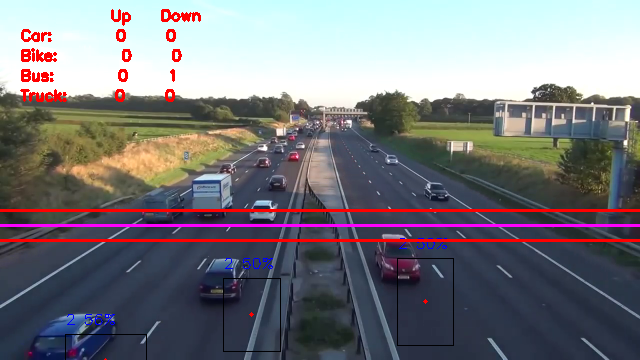

{'predictions': [{'x': 70.0, 'y': 332.5, 'width': 82, 'height': 55, 'class': '2', 'confidence': 0.576}, {'x': 400.0, 'y': 268.0, 'width': 46, 'height': 80, 'class': '2', 'confidence': 0.478}, {'x': 224.5, 'y': 275.5, 'width': 55, 'height': 83, 'class': '2', 'confidence': 0.438}]}


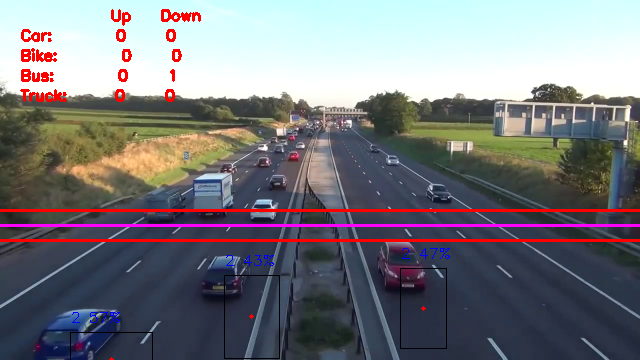

{'predictions': [{'x': 226.0, 'y': 275.0, 'width': 40, 'height': 66, 'class': '2', 'confidence': 0.57}, {'x': 403.5, 'y': 276.0, 'width': 51, 'height': 66, 'class': '2', 'confidence': 0.452}, {'x': 80.0, 'y': 324.0, 'width': 84, 'height': 72, 'class': '2', 'confidence': 0.41}]}


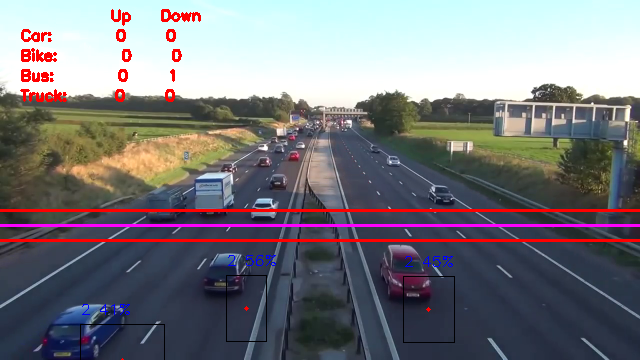

{'predictions': [{'x': 226.0, 'y': 275.0, 'width': 40, 'height': 66, 'class': '2', 'confidence': 0.573}, {'x': 403.5, 'y': 276.0, 'width': 51, 'height': 66, 'class': '2', 'confidence': 0.456}, {'x': 80.0, 'y': 324.0, 'width': 84, 'height': 72, 'class': '2', 'confidence': 0.408}]}


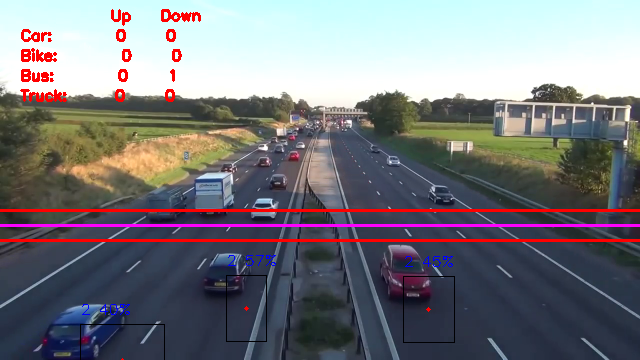

{'predictions': [{'x': 225.5, 'y': 271.5, 'width': 41, 'height': 67, 'class': '2', 'confidence': 0.585}, {'x': 407.0, 'y': 283.5, 'width': 42, 'height': 83, 'class': '2', 'confidence': 0.522}, {'x': 84.0, 'y': 321.0, 'width': 78, 'height': 78, 'class': '2', 'confidence': 0.425}]}


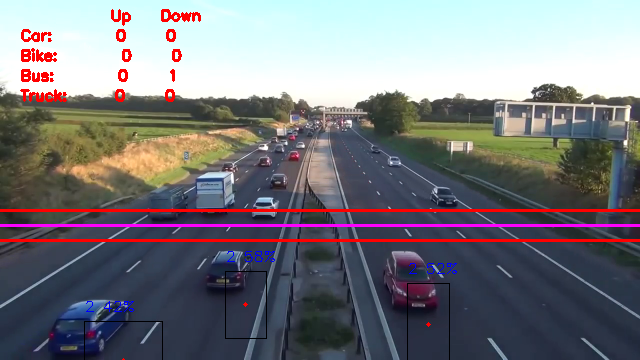

{'predictions': [{'x': 89.0, 'y': 329.0, 'width': 62, 'height': 62, 'class': '2', 'confidence': 0.666}, {'x': 226.5, 'y': 269.0, 'width': 43, 'height': 68, 'class': '2', 'confidence': 0.568}, {'x': 416.0, 'y': 286.0, 'width': 66, 'height': 98, 'class': '2', 'confidence': 0.518}]}


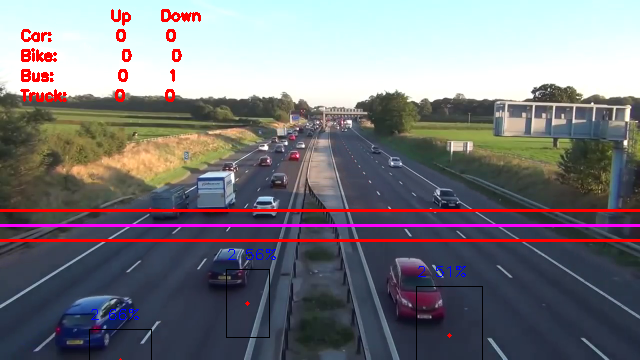

{'predictions': [{'x': 426.5, 'y': 291.0, 'width': 57, 'height': 98, 'class': '1', 'confidence': 0.618}, {'x': 94.0, 'y': 320.0, 'width': 62, 'height': 76, 'class': '2', 'confidence': 0.515}, {'x': 228.0, 'y': 267.0, 'width': 40, 'height': 66, 'class': '2', 'confidence': 0.485}, {'x': 421.5, 'y': 303.0, 'width': 61, 'height': 110, 'class': '2', 'confidence': 0.414}]}


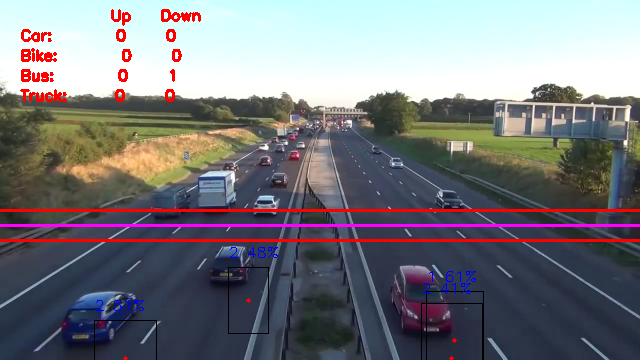

{'predictions': [{'x': 426.5, 'y': 316.0, 'width': 63, 'height': 88, 'class': '2', 'confidence': 0.608}, {'x': 100.0, 'y': 317.5, 'width': 58, 'height': 79, 'class': '2', 'confidence': 0.506}, {'x': 230.0, 'y': 263.0, 'width': 32, 'height': 64, 'class': '2', 'confidence': 0.445}]}


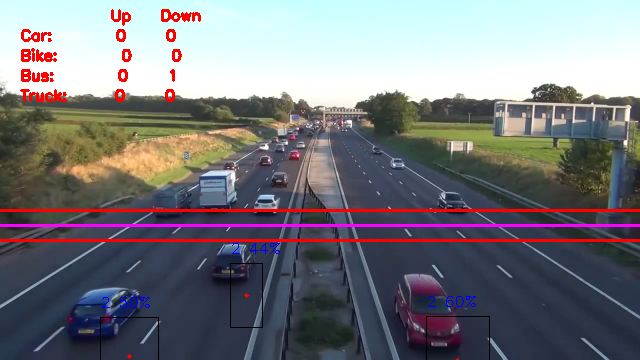

{'predictions': [{'x': 431.5, 'y': 321.5, 'width': 63, 'height': 77, 'class': '2', 'confidence': 0.554}, {'x': 105.0, 'y': 314.5, 'width': 54, 'height': 79, 'class': '2', 'confidence': 0.518}, {'x': 234.5, 'y': 260.0, 'width': 41, 'height': 64, 'class': '2', 'confidence': 0.477}, {'x': 456.0, 'y': 204.5, 'width': 26, 'height': 43, 'class': '2', 'confidence': 0.4}]}


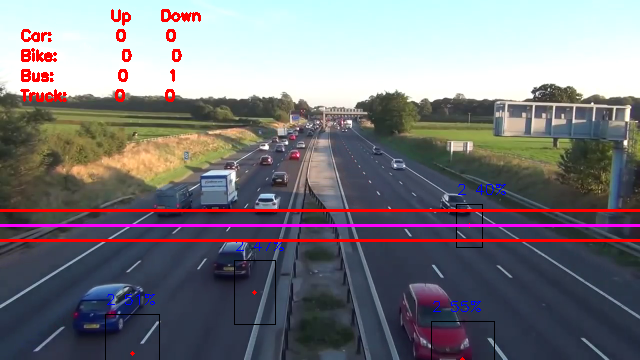

{'predictions': [{'x': 431.5, 'y': 321.5, 'width': 63, 'height': 77, 'class': '2', 'confidence': 0.557}, {'x': 105.0, 'y': 314.5, 'width': 54, 'height': 79, 'class': '2', 'confidence': 0.519}, {'x': 234.5, 'y': 260.0, 'width': 41, 'height': 64, 'class': '2', 'confidence': 0.476}, {'x': 456.0, 'y': 204.5, 'width': 26, 'height': 43, 'class': '2', 'confidence': 0.41}]}


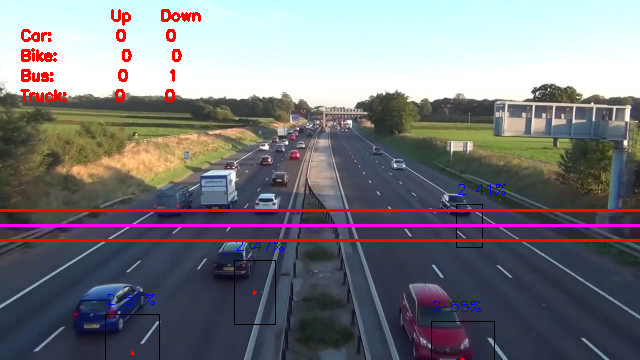

{'predictions': [{'x': 112.5, 'y': 302.5, 'width': 71, 'height': 85, 'class': '2', 'confidence': 0.541}, {'x': 235.0, 'y': 257.0, 'width': 40, 'height': 58, 'class': '2', 'confidence': 0.452}, {'x': 456.0, 'y': 204.5, 'width': 36, 'height': 27, 'class': '2', 'confidence': 0.445}, {'x': 442.5, 'y': 317.0, 'width': 75, 'height': 86, 'class': '2', 'confidence': 0.436}]}


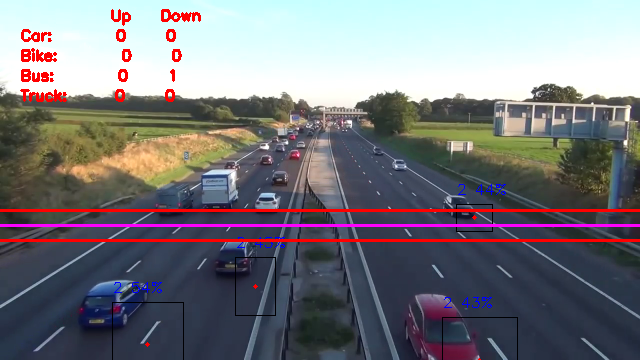

{'predictions': [{'x': 118.0, 'y': 296.0, 'width': 72, 'height': 78, 'class': '2', 'confidence': 0.76}, {'x': 233.0, 'y': 252.0, 'width': 36, 'height': 52, 'class': '2', 'confidence': 0.446}, {'x': 462.0, 'y': 207.5, 'width': 32, 'height': 37, 'class': '2', 'confidence': 0.402}]}


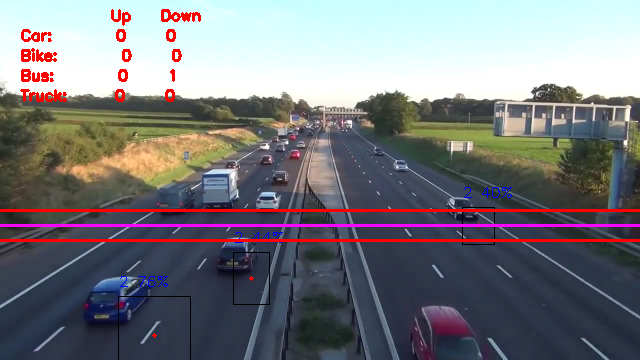

{'predictions': [{'x': 466.0, 'y': 210.0, 'width': 34, 'height': 36, 'class': '2', 'confidence': 0.463}, {'x': 237.5, 'y': 252.5, 'width': 45, 'height': 49, 'class': '2', 'confidence': 0.444}, {'x': 123.0, 'y': 288.0, 'width': 68, 'height': 92, 'class': '2', 'confidence': 0.425}]}


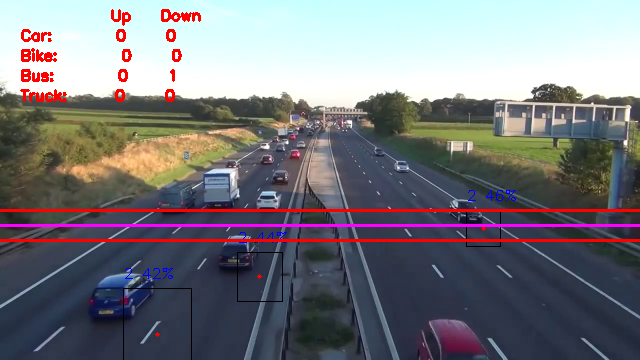

{'predictions': [{'x': 468.5, 'y': 213.5, 'width': 39, 'height': 37, 'class': '2', 'confidence': 0.511}, {'x': 125.5, 'y': 292.5, 'width': 57, 'height': 71, 'class': '2', 'confidence': 0.494}]}


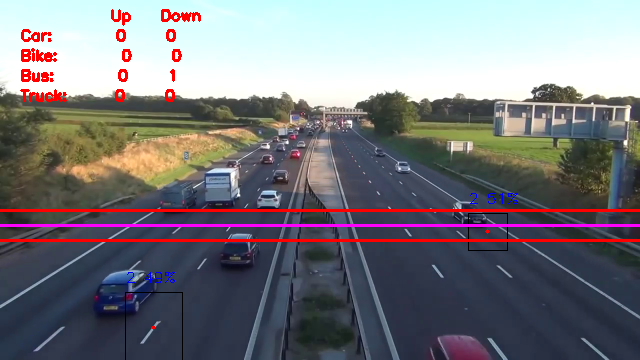

{'predictions': [{'x': 129.5, 'y': 295.0, 'width': 49, 'height': 74, 'class': '2', 'confidence': 0.563}, {'x': 239.0, 'y': 245.5, 'width': 42, 'height': 47, 'class': '2', 'confidence': 0.433}, {'x': 473.5, 'y': 215.0, 'width': 43, 'height': 46, 'class': '2', 'confidence': 0.4}]}


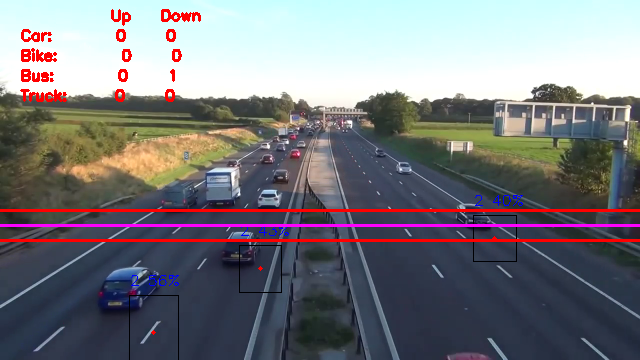

{'predictions': [{'x': 129.5, 'y': 295.0, 'width': 49, 'height': 74, 'class': '2', 'confidence': 0.564}, {'x': 239.0, 'y': 245.5, 'width': 42, 'height': 47, 'class': '2', 'confidence': 0.434}]}


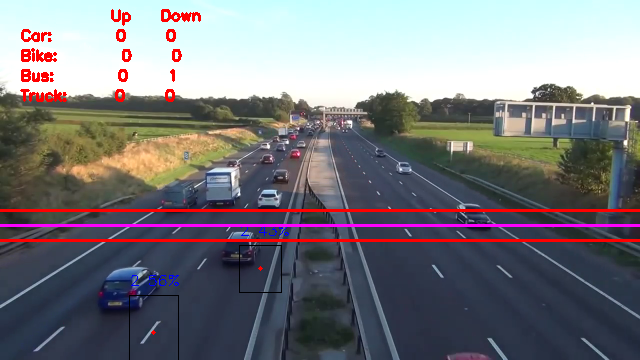

{'predictions': [{'x': 131.5, 'y': 294.0, 'width': 51, 'height': 68, 'class': '2', 'confidence': 0.581}, {'x': 242.0, 'y': 243.0, 'width': 40, 'height': 50, 'class': '2', 'confidence': 0.475}, {'x': 477.5, 'y': 219.5, 'width': 29, 'height': 35, 'class': '2', 'confidence': 0.444}]}


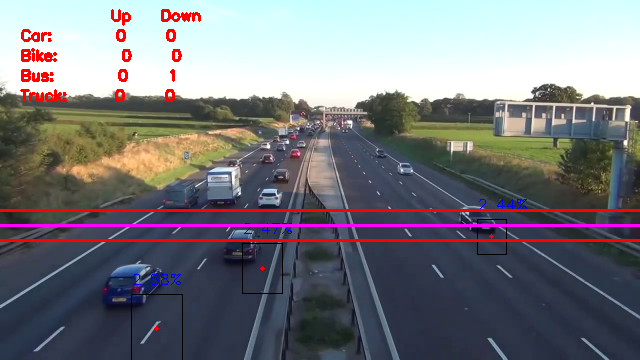

{'predictions': [{'x': 134.5, 'y': 292.0, 'width': 51, 'height': 60, 'class': '2', 'confidence': 0.573}, {'x': 243.5, 'y': 241.5, 'width': 43, 'height': 49, 'class': '2', 'confidence': 0.452}, {'x': 481.5, 'y': 220.0, 'width': 37, 'height': 40, 'class': '2', 'confidence': 0.4}]}


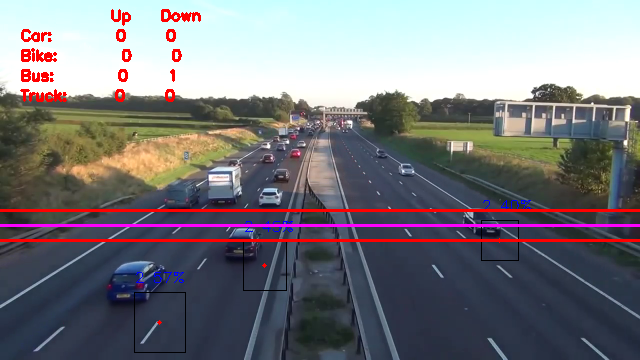

{'predictions': [{'x': 137.0, 'y': 288.5, 'width': 52, 'height': 57, 'class': '2', 'confidence': 0.553}, {'x': 484.5, 'y': 226.0, 'width': 53, 'height': 46, 'class': '2', 'confidence': 0.468}, {'x': 244.5, 'y': 241.5, 'width': 43, 'height': 47, 'class': '2', 'confidence': 0.437}]}


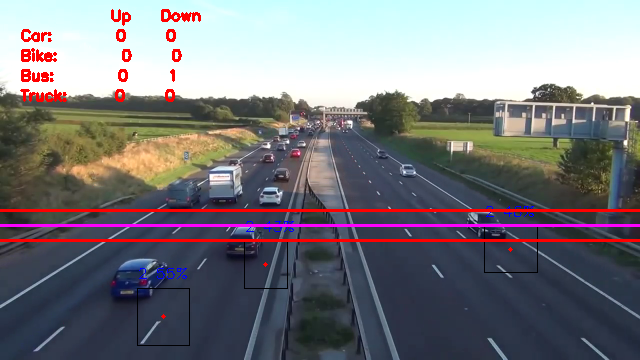

{'predictions': [{'x': 141.0, 'y': 284.0, 'width': 54, 'height': 54, 'class': '2', 'confidence': 0.508}, {'x': 489.5, 'y': 229.0, 'width': 37, 'height': 46, 'class': '2', 'confidence': 0.496}, {'x': 246.0, 'y': 238.5, 'width': 34, 'height': 43, 'class': '2', 'confidence': 0.4}]}


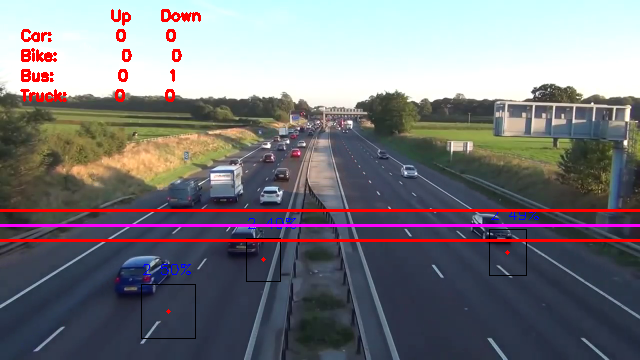

{'predictions': [{'x': 143.0, 'y': 281.5, 'width': 52, 'height': 55, 'class': '2', 'confidence': 0.483}, {'x': 497.0, 'y': 231.0, 'width': 56, 'height': 52, 'class': '2', 'confidence': 0.44}, {'x': 244.0, 'y': 237.0, 'width': 38, 'height': 52, 'class': '2', 'confidence': 0.417}]}


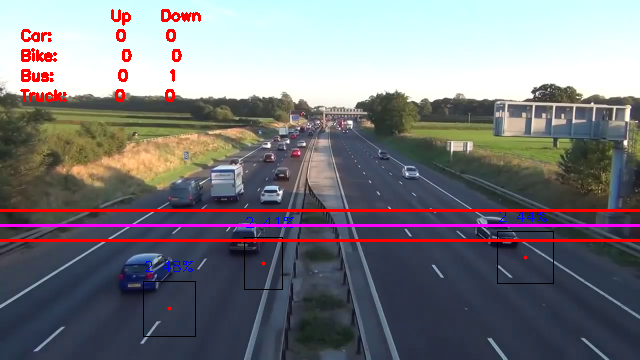

{'predictions': [{'x': 494.5, 'y': 232.5, 'width': 41, 'height': 49, 'class': '2', 'confidence': 0.526}, {'x': 143.0, 'y': 281.5, 'width': 52, 'height': 55, 'class': '2', 'confidence': 0.481}, {'x': 244.0, 'y': 237.0, 'width': 38, 'height': 52, 'class': '2', 'confidence': 0.415}]}


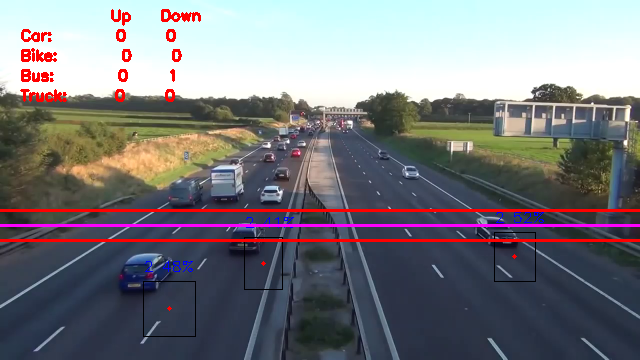

{'predictions': [{'x': 497.0, 'y': 235.0, 'width': 40, 'height': 60, 'class': '2', 'confidence': 0.566}, {'x': 146.5, 'y': 278.0, 'width': 49, 'height': 54, 'class': '2', 'confidence': 0.48}, {'x': 248.5, 'y': 237.0, 'width': 35, 'height': 52, 'class': '2', 'confidence': 0.478}]}


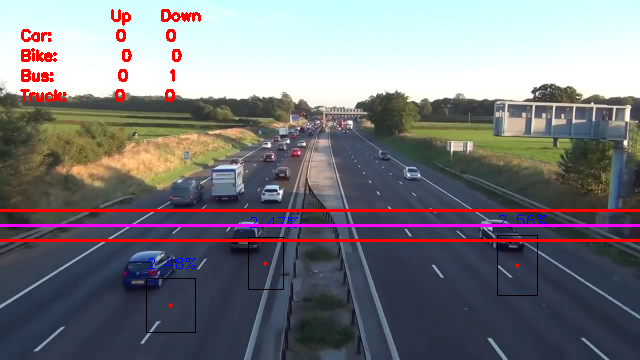

{'predictions': [{'x': 151.5, 'y': 268.0, 'width': 47, 'height': 60, 'class': '2', 'confidence': 0.597}, {'x': 247.5, 'y': 235.0, 'width': 37, 'height': 46, 'class': '2', 'confidence': 0.544}, {'x': 502.5, 'y': 238.5, 'width': 35, 'height': 61, 'class': '2', 'confidence': 0.427}]}


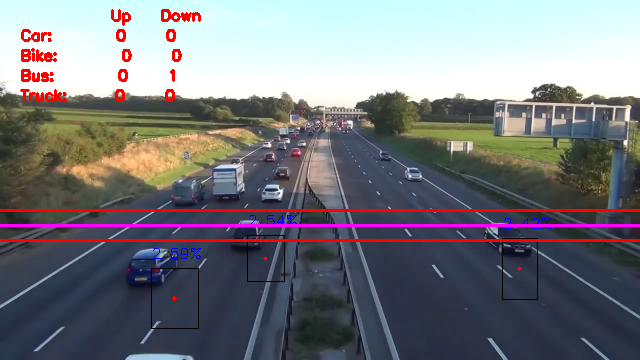

{'predictions': [{'x': 151.5, 'y': 262.0, 'width': 51, 'height': 72, 'class': '2', 'confidence': 0.478}, {'x': 244.5, 'y': 233.0, 'width': 43, 'height': 48, 'class': '2', 'confidence': 0.464}, {'x': 508.5, 'y': 243.0, 'width': 39, 'height': 64, 'class': '2', 'confidence': 0.428}]}


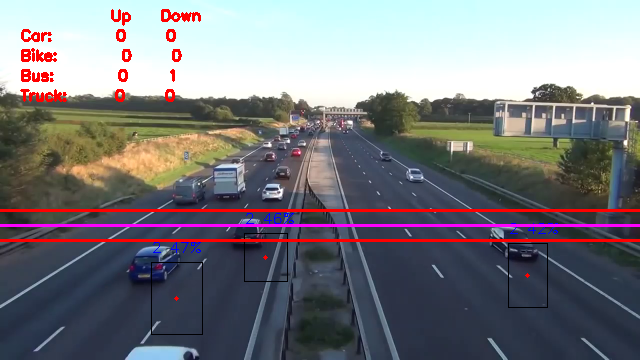

{'predictions': [{'x': 153.5, 'y': 260.5, 'width': 43, 'height': 63, 'class': '2', 'confidence': 0.602}, {'x': 519.5, 'y': 248.5, 'width': 51, 'height': 51, 'class': '2', 'confidence': 0.475}, {'x': 248.5, 'y': 230.0, 'width': 45, 'height': 50, 'class': '2', 'confidence': 0.426}]}


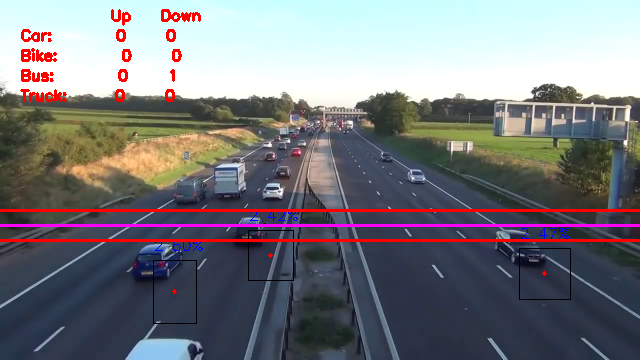

{'predictions': [{'x': 527.5, 'y': 251.0, 'width': 61, 'height': 62, 'class': '2', 'confidence': 0.477}, {'x': 250.0, 'y': 227.0, 'width': 44, 'height': 44, 'class': '2', 'confidence': 0.428}, {'x': 155.5, 'y': 263.0, 'width': 49, 'height': 50, 'class': '2', 'confidence': 0.412}]}


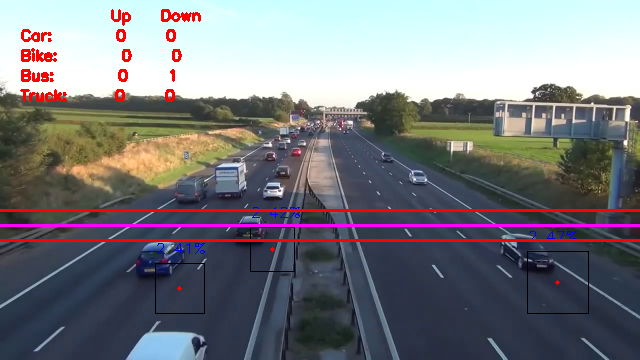

{'predictions': [{'x': 527.5, 'y': 251.0, 'width': 61, 'height': 62, 'class': '2', 'confidence': 0.475}, {'x': 250.0, 'y': 227.0, 'width': 44, 'height': 44, 'class': '2', 'confidence': 0.429}, {'x': 155.5, 'y': 263.0, 'width': 49, 'height': 50, 'class': '2', 'confidence': 0.413}]}


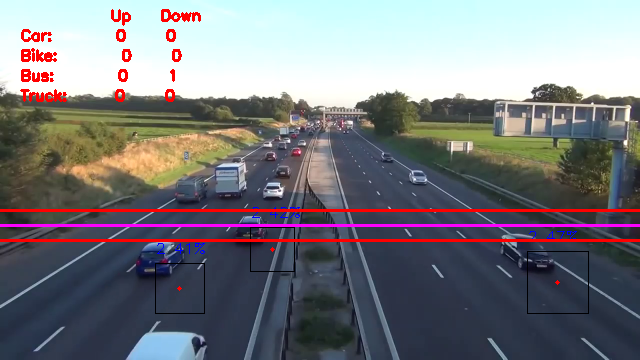

{'predictions': [{'x': 525.0, 'y': 260.0, 'width': 54, 'height': 64, 'class': '2', 'confidence': 0.485}, {'x': 157.0, 'y': 261.5, 'width': 50, 'height': 49, 'class': '2', 'confidence': 0.429}]}


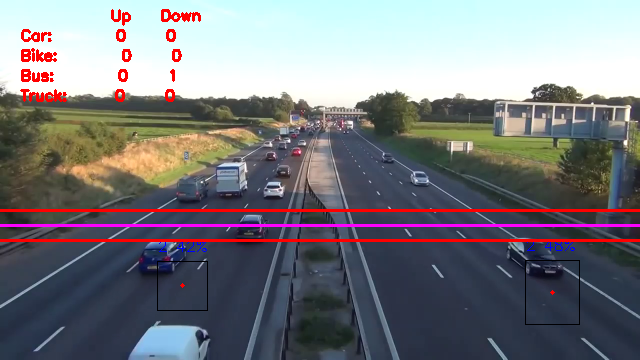

{'predictions': [{'x': 253.0, 'y': 225.5, 'width': 38, 'height': 45, 'class': '2', 'confidence': 0.454}, {'x': 535.5, 'y': 261.5, 'width': 53, 'height': 65, 'class': '2', 'confidence': 0.407}, {'x': 162.0, 'y': 253.5, 'width': 54, 'height': 63, 'class': '2', 'confidence': 0.407}]}


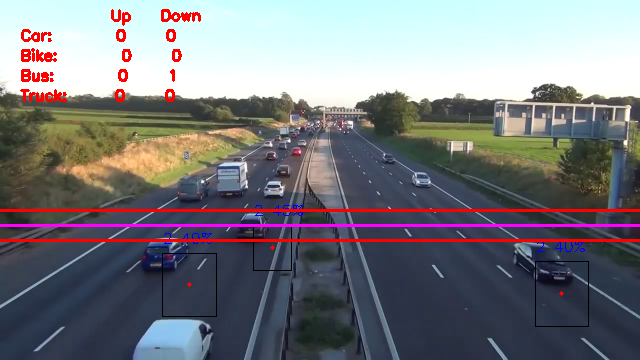

{'predictions': [{'x': 165.0, 'y': 253.0, 'width': 40, 'height': 48, 'class': '2', 'confidence': 0.511}, {'x': 254.5, 'y': 224.5, 'width': 35, 'height': 43, 'class': '2', 'confidence': 0.449}, {'x': 546.5, 'y': 270.0, 'width': 49, 'height': 66, 'class': '2', 'confidence': 0.429}]}


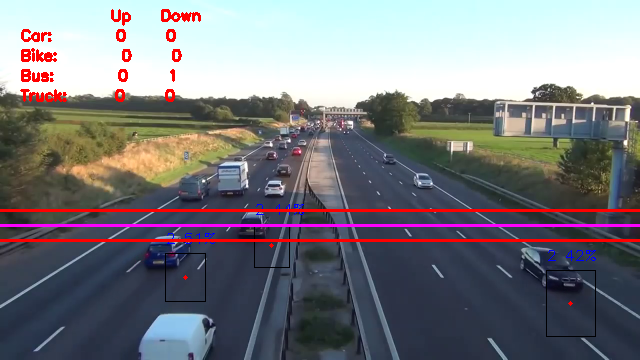

{'predictions': [{'x': 254.5, 'y': 222.5, 'width': 29, 'height': 39, 'class': '2', 'confidence': 0.561}, {'x': 165.5, 'y': 251.0, 'width': 39, 'height': 46, 'class': '2', 'confidence': 0.473}, {'x': 555.5, 'y': 277.0, 'width': 59, 'height': 62, 'class': '2', 'confidence': 0.431}]}


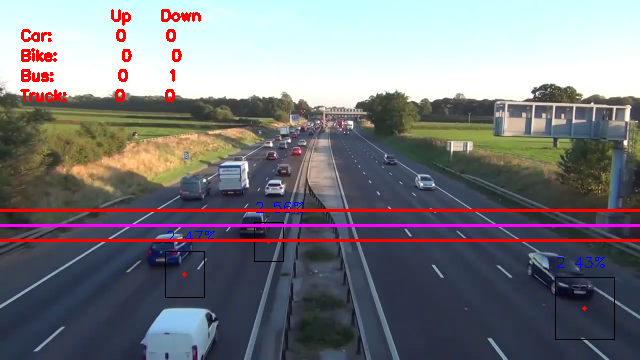

{'predictions': [{'x': 568.0, 'y': 277.0, 'width': 74, 'height': 90, 'class': '2', 'confidence': 0.556}, {'x': 169.5, 'y': 248.5, 'width': 37, 'height': 47, 'class': '2', 'confidence': 0.522}, {'x': 254.0, 'y': 219.5, 'width': 34, 'height': 45, 'class': '2', 'confidence': 0.443}]}


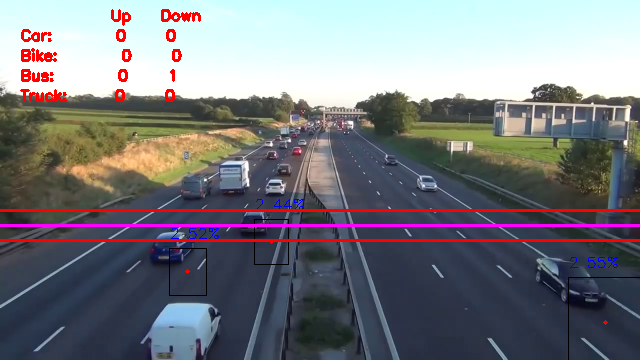

{'predictions': [{'x': 568.0, 'y': 277.0, 'width': 74, 'height': 90, 'class': '2', 'confidence': 0.556}, {'x': 169.5, 'y': 248.5, 'width': 37, 'height': 47, 'class': '2', 'confidence': 0.517}, {'x': 254.0, 'y': 219.5, 'width': 34, 'height': 45, 'class': '2', 'confidence': 0.448}]}


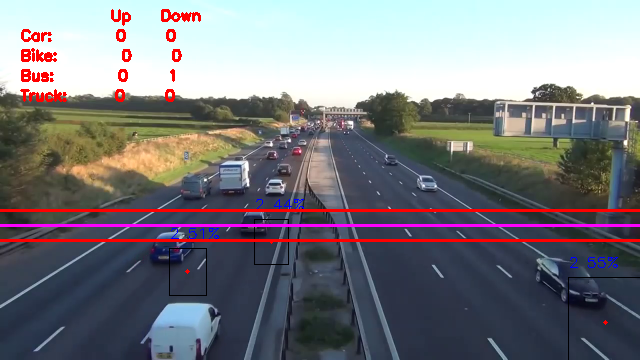

{'predictions': [{'x': 575.5, 'y': 292.5, 'width': 55, 'height': 83, 'class': '2', 'confidence': 0.628}, {'x': 173.0, 'y': 246.0, 'width': 36, 'height': 52, 'class': '2', 'confidence': 0.456}, {'x': 254.5, 'y': 217.5, 'width': 35, 'height': 45, 'class': '2', 'confidence': 0.438}]}


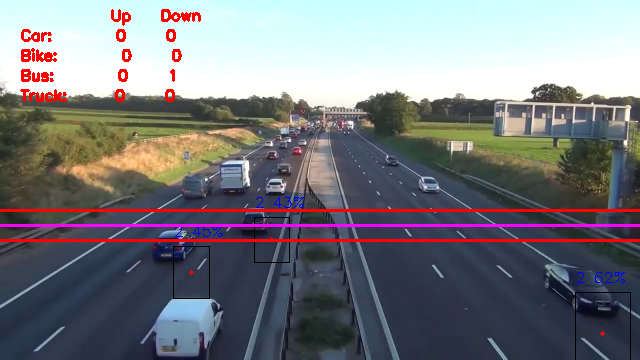

{'predictions': [{'x': 176.0, 'y': 244.5, 'width': 36, 'height': 55, 'class': '2', 'confidence': 0.489}, {'x': 194.5, 'y': 318.5, 'width': 51, 'height': 83, 'class': '1', 'confidence': 0.436}, {'x': 255.5, 'y': 217.5, 'width': 37, 'height': 45, 'class': '2', 'confidence': 0.421}, {'x': 588.5, 'y': 293.0, 'width': 75, 'height': 84, 'class': '2', 'confidence': 0.416}]}


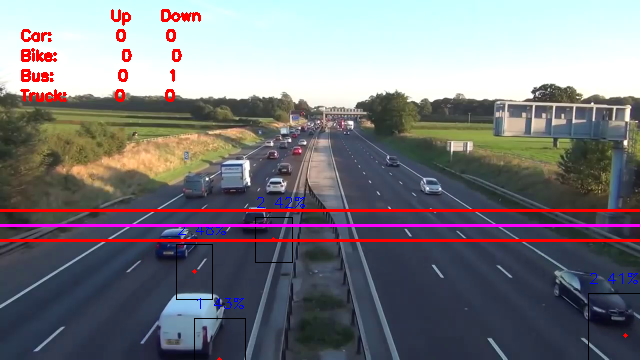

{'predictions': [{'x': 177.5, 'y': 243.0, 'width': 35, 'height': 56, 'class': '2', 'confidence': 0.477}, {'x': 598.0, 'y': 303.5, 'width': 60, 'height': 83, 'class': '2', 'confidence': 0.429}, {'x': 259.0, 'y': 215.5, 'width': 26, 'height': 43, 'class': '2', 'confidence': 0.425}]}


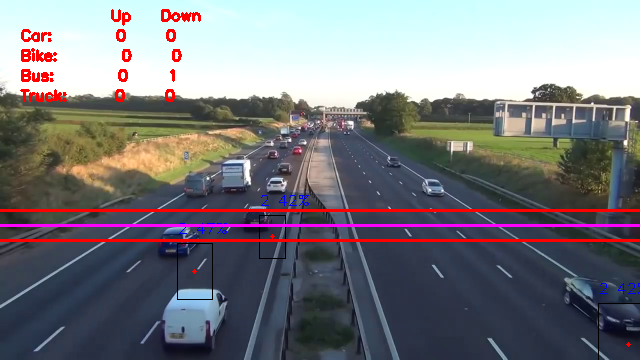

{'predictions': [{'x': 607.5, 'y': 307.5, 'width': 55, 'height': 105, 'class': '2', 'confidence': 0.574}, {'x': 261.0, 'y': 215.5, 'width': 26, 'height': 43, 'class': '2', 'confidence': 0.527}, {'x': 179.0, 'y': 240.0, 'width': 32, 'height': 50, 'class': '2', 'confidence': 0.493}]}


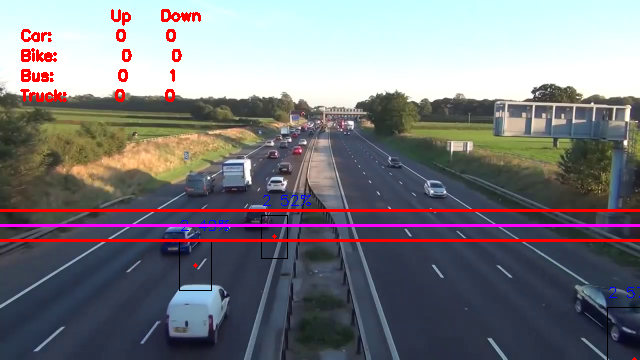

{'predictions': [{'x': 261.0, 'y': 216.0, 'width': 26, 'height': 44, 'class': '2', 'confidence': 0.503}, {'x': 180.0, 'y': 237.0, 'width': 34, 'height': 56, 'class': '2', 'confidence': 0.493}, {'x': 201.0, 'y': 305.0, 'width': 60, 'height': 74, 'class': '2', 'confidence': 0.458}, {'x': 609.0, 'y': 317.0, 'width': 46, 'height': 86, 'class': '2', 'confidence': 0.403}]}


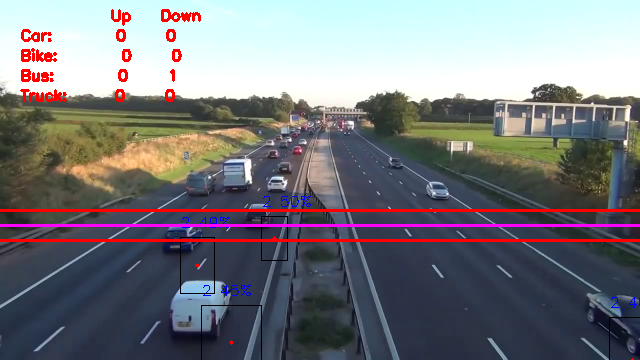

{'predictions': [{'x': 261.0, 'y': 216.0, 'width': 26, 'height': 44, 'class': '2', 'confidence': 0.509}, {'x': 179.5, 'y': 237.0, 'width': 35, 'height': 56, 'class': '2', 'confidence': 0.494}, {'x': 201.0, 'y': 305.0, 'width': 60, 'height': 74, 'class': '2', 'confidence': 0.46}]}


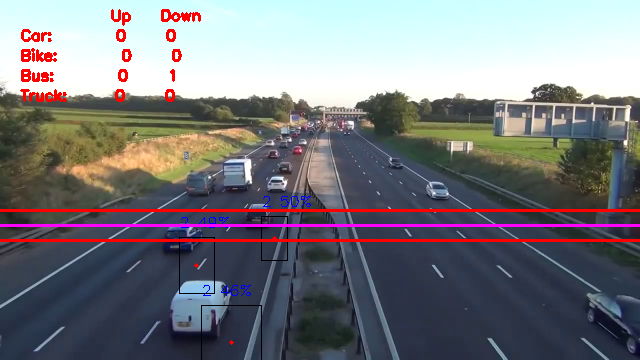

{'predictions': [{'x': 181.0, 'y': 235.5, 'width': 32, 'height': 55, 'class': '2', 'confidence': 0.556}, {'x': 206.5, 'y': 300.0, 'width': 63, 'height': 80, 'class': '2', 'confidence': 0.48}, {'x': 260.5, 'y': 214.5, 'width': 23, 'height': 45, 'class': '2', 'confidence': 0.458}]}


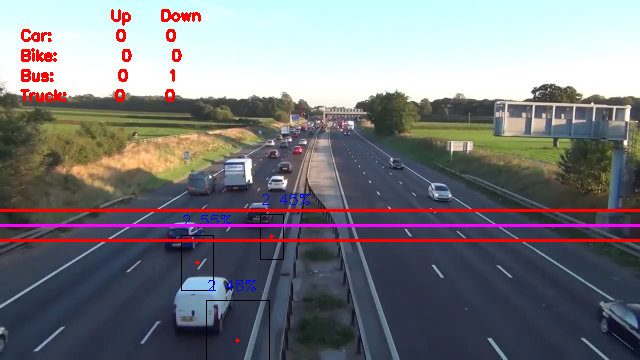

{'predictions': [{'x': 261.5, 'y': 214.5, 'width': 25, 'height': 41, 'class': '2', 'confidence': 0.606}, {'x': 187.0, 'y': 234.5, 'width': 38, 'height': 51, 'class': '2', 'confidence': 0.571}]}


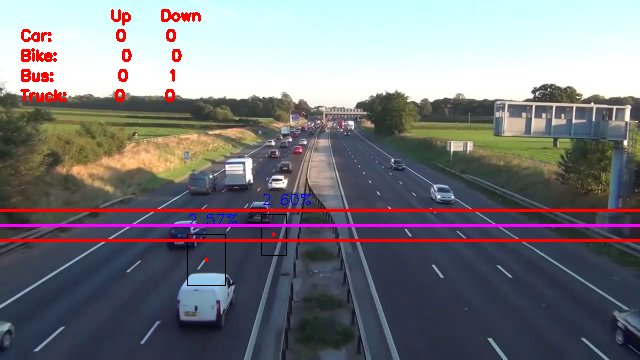

{'predictions': [{'x': 261.5, 'y': 214.5, 'width': 25, 'height': 41, 'class': '2', 'confidence': 0.63}, {'x': 187.0, 'y': 235.5, 'width': 30, 'height': 49, 'class': '2', 'confidence': 0.604}, {'x': 204.0, 'y': 292.0, 'width': 44, 'height': 80, 'class': '2', 'confidence': 0.439}]}


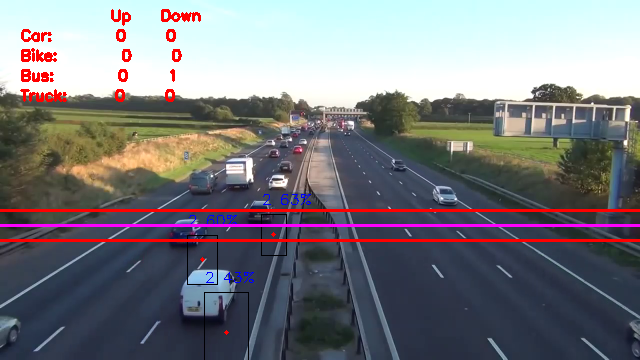

{'predictions': [{'x': 261.5, 'y': 214.0, 'width': 27, 'height': 40, 'class': '2', 'confidence': 0.616}, {'x': 187.0, 'y': 234.5, 'width': 30, 'height': 47, 'class': '2', 'confidence': 0.475}, {'x': 207.0, 'y': 289.0, 'width': 42, 'height': 80, 'class': '2', 'confidence': 0.436}]}


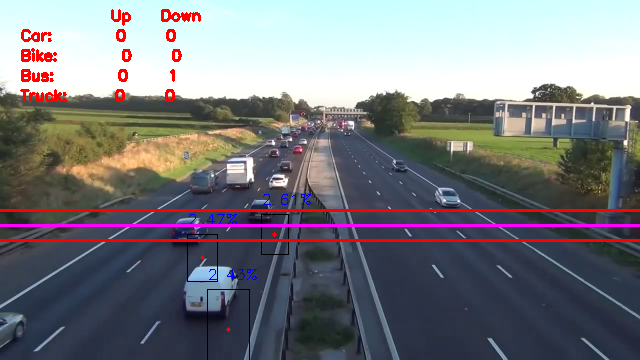

{'predictions': [{'x': 261.5, 'y': 213.0, 'width': 31, 'height': 38, 'class': '2', 'confidence': 0.582}, {'x': 208.5, 'y': 285.5, 'width': 39, 'height': 75, 'class': '2', 'confidence': 0.453}, {'x': 191.5, 'y': 231.0, 'width': 39, 'height': 40, 'class': '2', 'confidence': 0.411}]}


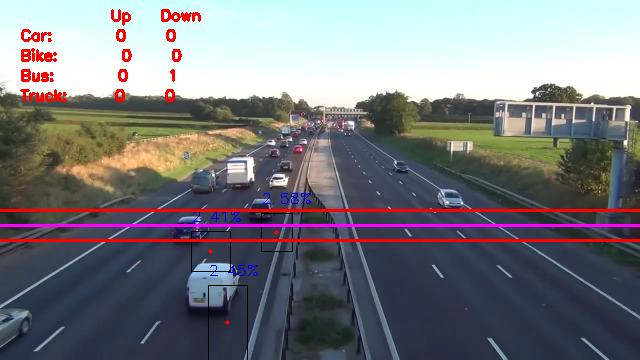

{'predictions': [{'x': 261.5, 'y': 213.0, 'width': 31, 'height': 38, 'class': '2', 'confidence': 0.594}, {'x': 208.5, 'y': 285.5, 'width': 39, 'height': 75, 'class': '2', 'confidence': 0.458}, {'x': 191.5, 'y': 231.0, 'width': 39, 'height': 40, 'class': '2', 'confidence': 0.407}]}


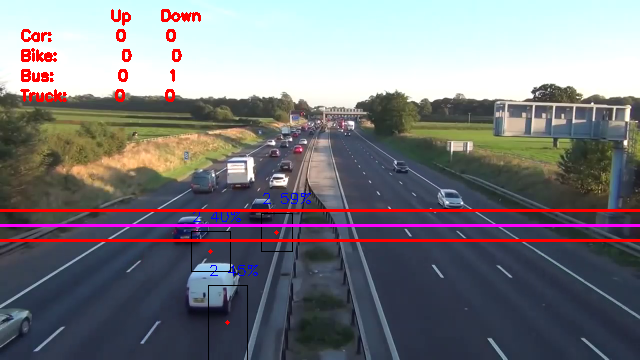

{'predictions': [{'x': 261.0, 'y': 211.5, 'width': 26, 'height': 41, 'class': '2', 'confidence': 0.53}, {'x': 190.0, 'y': 229.5, 'width': 32, 'height': 43, 'class': '2', 'confidence': 0.477}, {'x': 221.5, 'y': 283.5, 'width': 61, 'height': 57, 'class': '2', 'confidence': 0.435}]}


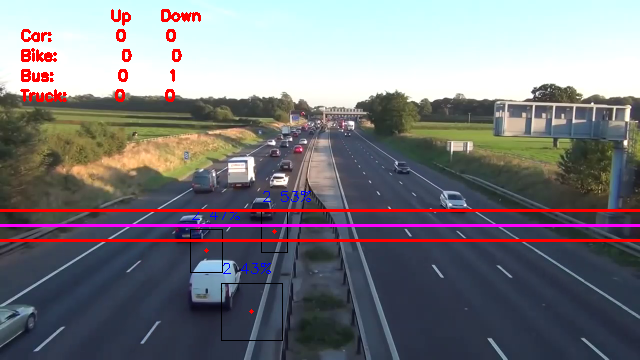

{'predictions': [{'x': 191.5, 'y': 227.5, 'width': 35, 'height': 43, 'class': '2', 'confidence': 0.474}, {'x': 221.0, 'y': 278.0, 'width': 60, 'height': 72, 'class': '2', 'confidence': 0.448}, {'x': 260.5, 'y': 211.0, 'width': 23, 'height': 40, 'class': '2', 'confidence': 0.442}]}


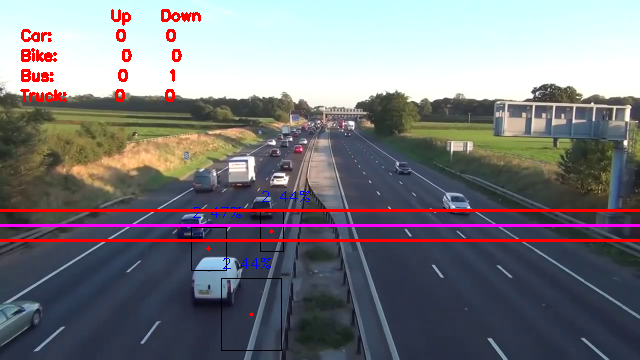

{'predictions': [{'x': 196.5, 'y': 225.0, 'width': 37, 'height': 40, 'class': '2', 'confidence': 0.479}]}


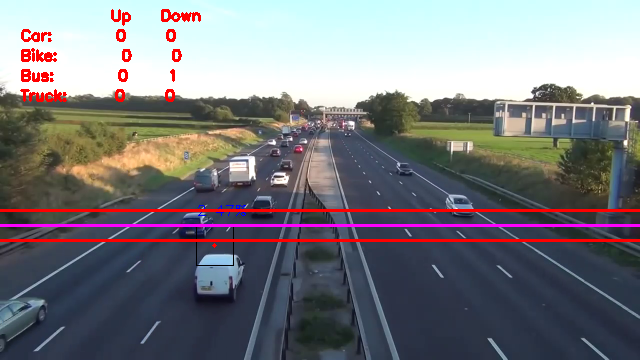

{'predictions': [{'x': 197.5, 'y': 222.5, 'width': 35, 'height': 39, 'class': '2', 'confidence': 0.46}, {'x': 29.5, 'y': 317.0, 'width': 43, 'height': 86, 'class': '2', 'confidence': 0.435}, {'x': 224.5, 'y': 274.0, 'width': 61, 'height': 52, 'class': '2', 'confidence': 0.4}]}


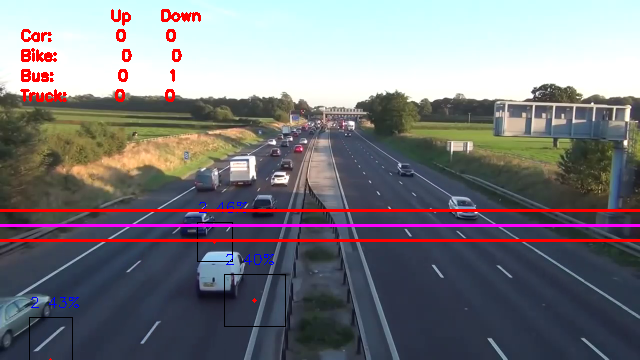

{'predictions': [{'x': 29.0, 'y': 323.0, 'width': 46, 'height': 74, 'class': '2', 'confidence': 0.581}, {'x': 195.5, 'y': 220.5, 'width': 43, 'height': 45, 'class': '2', 'confidence': 0.409}]}


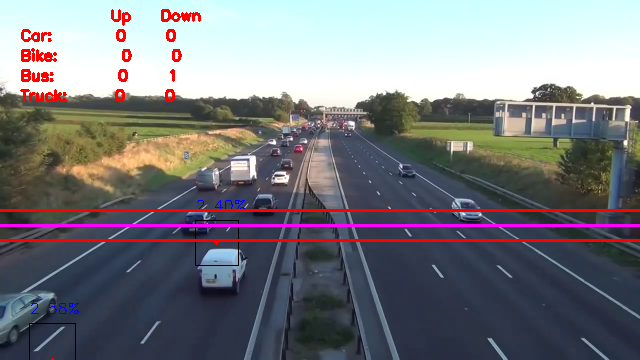

{'predictions': [{'x': 29.0, 'y': 323.0, 'width': 46, 'height': 74, 'class': '2', 'confidence': 0.575}, {'x': 195.5, 'y': 220.5, 'width': 43, 'height': 45, 'class': '2', 'confidence': 0.403}]}


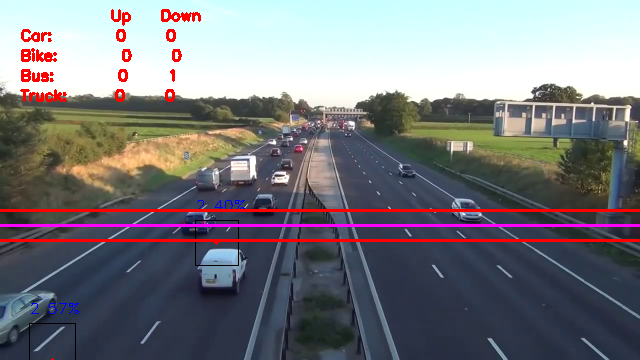

{'predictions': [{'x': 29.5, 'y': 321.0, 'width': 49, 'height': 78, 'class': '2', 'confidence': 0.638}, {'x': 196.5, 'y': 218.5, 'width': 43, 'height': 43, 'class': '2', 'confidence': 0.401}]}


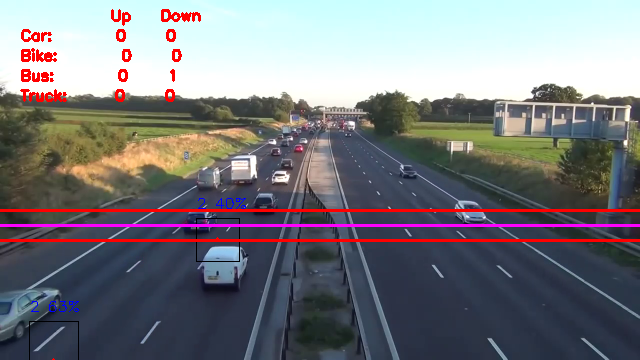

{'predictions': [{'x': 30.5, 'y': 319.0, 'width': 55, 'height': 78, 'class': '2', 'confidence': 0.624}, {'x': 227.5, 'y': 265.0, 'width': 49, 'height': 46, 'class': '2', 'confidence': 0.494}, {'x': 202.5, 'y': 216.5, 'width': 35, 'height': 43, 'class': '2', 'confidence': 0.436}]}


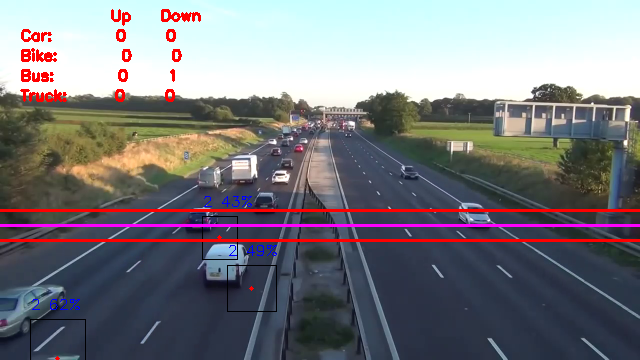

{'predictions': [{'x': 204.5, 'y': 215.5, 'width': 31, 'height': 43, 'class': '2', 'confidence': 0.44}, {'x': 230.0, 'y': 258.5, 'width': 48, 'height': 49, 'class': '2', 'confidence': 0.419}, {'x': 31.0, 'y': 315.5, 'width': 58, 'height': 71, 'class': '2', 'confidence': 0.414}]}


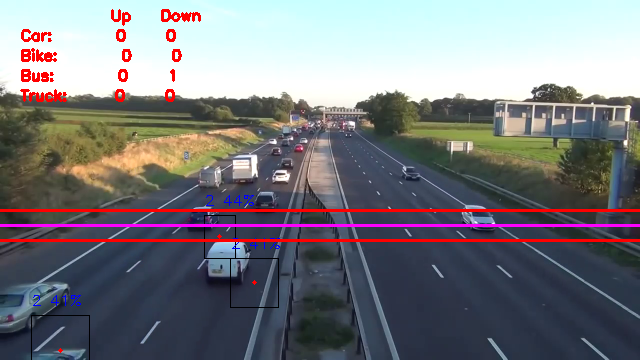

{'predictions': [{'x': 228.0, 'y': 257.5, 'width': 34, 'height': 57, 'class': '2', 'confidence': 0.482}, {'x': 207.0, 'y': 217.0, 'width': 32, 'height': 40, 'class': '2', 'confidence': 0.454}, {'x': 37.0, 'y': 300.0, 'width': 74, 'height': 90, 'class': '2', 'confidence': 0.433}]}


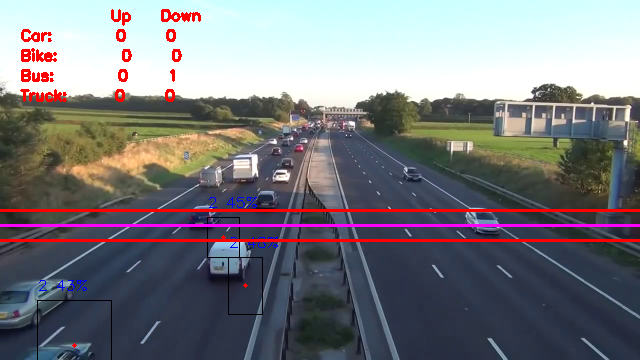

{'predictions': [{'x': 210.0, 'y': 216.0, 'width': 38, 'height': 42, 'class': '2', 'confidence': 0.483}, {'x': 37.0, 'y': 299.0, 'width': 64, 'height': 78, 'class': '2', 'confidence': 0.444}]}


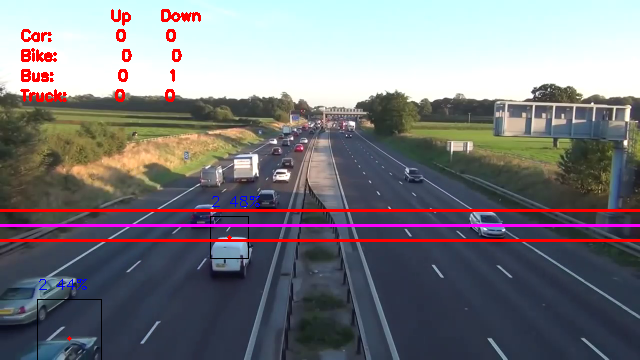

{'predictions': [{'x': 210.0, 'y': 216.0, 'width': 38, 'height': 42, 'class': '2', 'confidence': 0.488}, {'x': 37.5, 'y': 301.5, 'width': 63, 'height': 73, 'class': '2', 'confidence': 0.466}]}


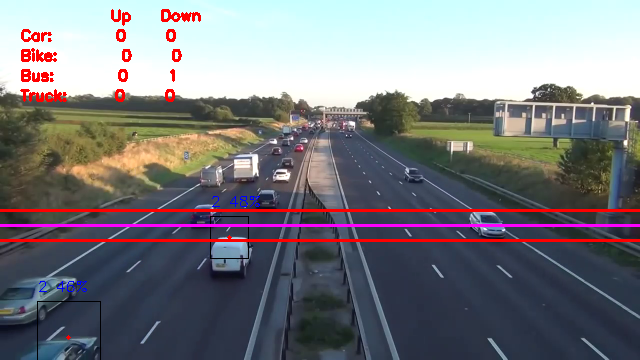

{'predictions': [{'x': 210.5, 'y': 215.0, 'width': 37, 'height': 40, 'class': '2', 'confidence': 0.565}, {'x': 38.0, 'y': 298.5, 'width': 66, 'height': 73, 'class': '2', 'confidence': 0.531}, {'x': 493.0, 'y': 228.0, 'width': 44, 'height': 46, 'class': '2', 'confidence': 0.415}, {'x': 235.0, 'y': 252.0, 'width': 46, 'height': 68, 'class': '2', 'confidence': 0.404}]}


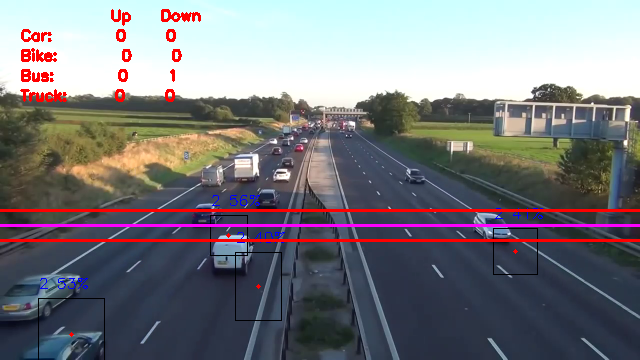

{'predictions': [{'x': 211.5, 'y': 215.0, 'width': 33, 'height': 40, 'class': '2', 'confidence': 0.65}, {'x': 42.0, 'y': 297.5, 'width': 66, 'height': 69, 'class': '2', 'confidence': 0.452}, {'x': 497.0, 'y': 230.5, 'width': 52, 'height': 49, 'class': '2', 'confidence': 0.443}, {'x': 236.0, 'y': 250.0, 'width': 42, 'height': 70, 'class': '2', 'confidence': 0.414}]}


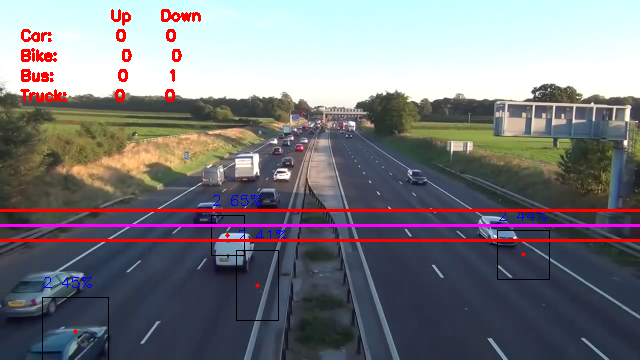

{'predictions': [{'x': 211.5, 'y': 214.5, 'width': 29, 'height': 39, 'class': '2', 'confidence': 0.71}, {'x': 46.5, 'y': 287.0, 'width': 83, 'height': 82, 'class': '2', 'confidence': 0.481}, {'x': 500.0, 'y': 234.0, 'width': 44, 'height': 56, 'class': '2', 'confidence': 0.405}]}


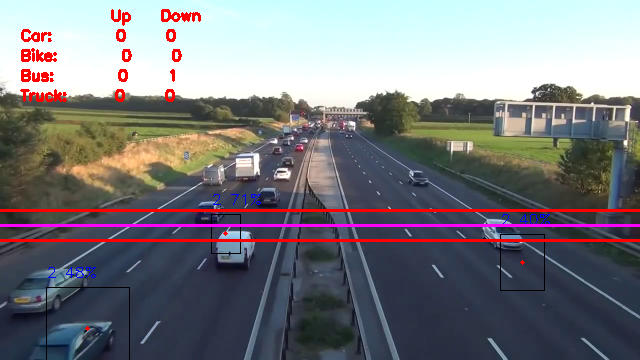

{'predictions': [{'x': 211.5, 'y': 213.5, 'width': 29, 'height': 37, 'class': '2', 'confidence': 0.623}, {'x': 509.5, 'y': 238.5, 'width': 49, 'height': 47, 'class': '2', 'confidence': 0.59}, {'x': 49.0, 'y': 294.0, 'width': 68, 'height': 62, 'class': '2', 'confidence': 0.567}, {'x': 236.0, 'y': 245.5, 'width': 42, 'height': 47, 'class': '2', 'confidence': 0.407}]}


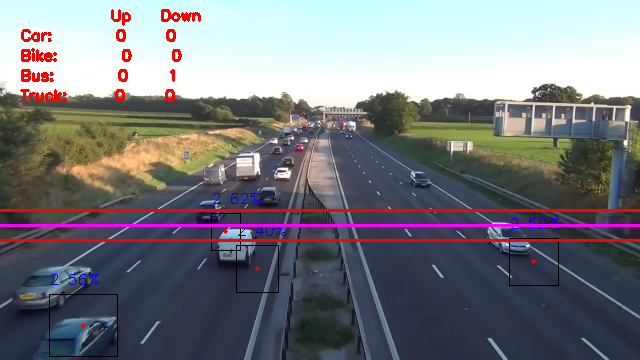

{'predictions': [{'x': 212.5, 'y': 213.5, 'width': 25, 'height': 37, 'class': '2', 'confidence': 0.695}, {'x': 55.0, 'y': 289.5, 'width': 60, 'height': 55, 'class': '2', 'confidence': 0.532}, {'x': 74.5, 'y': 332.5, 'width': 91, 'height': 55, 'class': '2', 'confidence': 0.44}, {'x': 509.0, 'y': 240.0, 'width': 40, 'height': 44, 'class': '2', 'confidence': 0.432}, {'x': 238.5, 'y': 242.0, 'width': 43, 'height': 48, 'class': '2', 'confidence': 0.42}]}


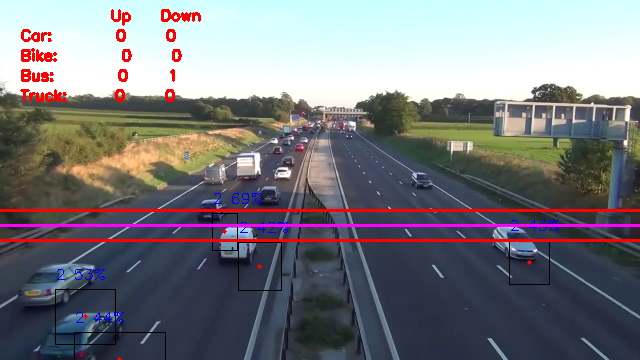

{'predictions': [{'x': 212.5, 'y': 213.5, 'width': 25, 'height': 37, 'class': '2', 'confidence': 0.696}, {'x': 55.0, 'y': 289.5, 'width': 60, 'height': 55, 'class': '2', 'confidence': 0.532}, {'x': 74.5, 'y': 332.5, 'width': 91, 'height': 55, 'class': '2', 'confidence': 0.445}, {'x': 509.0, 'y': 240.0, 'width': 40, 'height': 44, 'class': '2', 'confidence': 0.429}, {'x': 238.5, 'y': 242.0, 'width': 43, 'height': 48, 'class': '2', 'confidence': 0.42}]}


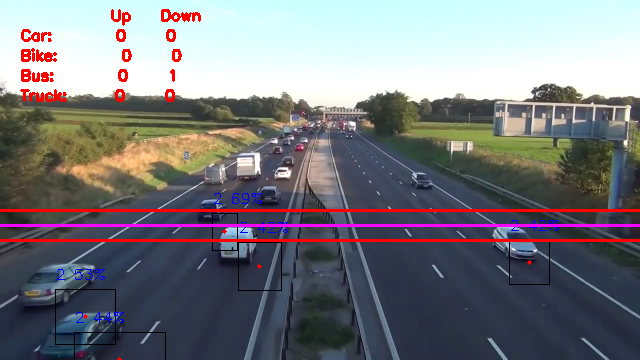

{'predictions': [{'x': 212.5, 'y': 212.0, 'width': 21, 'height': 34, 'class': '2', 'confidence': 0.591}, {'x': 520.5, 'y': 250.0, 'width': 45, 'height': 60, 'class': '2', 'confidence': 0.564}, {'x': 80.0, 'y': 331.0, 'width': 90, 'height': 58, 'class': '2', 'confidence': 0.501}, {'x': 58.5, 'y': 288.5, 'width': 61, 'height': 51, 'class': '2', 'confidence': 0.498}, {'x': 240.0, 'y': 240.0, 'width': 44, 'height': 50, 'class': '2', 'confidence': 0.44}]}


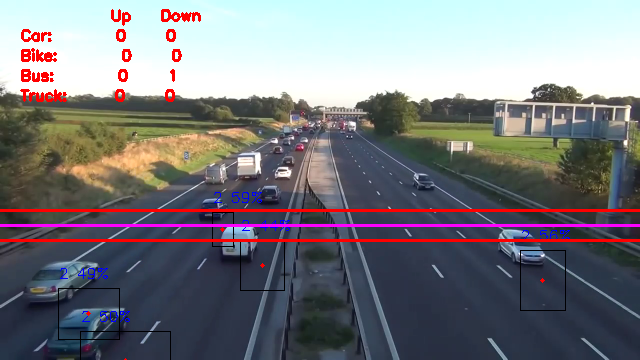

{'predictions': [{'x': 525.0, 'y': 253.5, 'width': 40, 'height': 57, 'class': '2', 'confidence': 0.528}, {'x': 212.5, 'y': 212.0, 'width': 15, 'height': 34, 'class': '2', 'confidence': 0.504}, {'x': 240.5, 'y': 239.0, 'width': 35, 'height': 48, 'class': '2', 'confidence': 0.497}, {'x': 91.5, 'y': 321.5, 'width': 81, 'height': 77, 'class': '2', 'confidence': 0.478}, {'x': 65.5, 'y': 277.0, 'width': 75, 'height': 68, 'class': '2', 'confidence': 0.437}]}


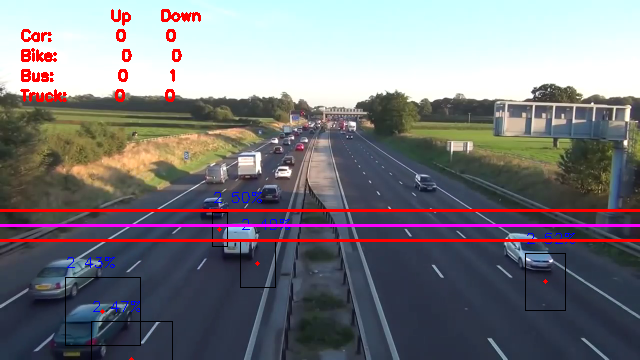

{'predictions': [{'x': 70.5, 'y': 273.0, 'width': 77, 'height': 66, 'class': '2', 'confidence': 0.596}, {'x': 95.5, 'y': 320.0, 'width': 77, 'height': 80, 'class': '2', 'confidence': 0.551}, {'x': 243.5, 'y': 237.0, 'width': 37, 'height': 46, 'class': '2', 'confidence': 0.461}, {'x': 211.5, 'y': 211.5, 'width': 13, 'height': 33, 'class': '2', 'confidence': 0.412}, {'x': 529.5, 'y': 266.5, 'width': 55, 'height': 49, 'class': '2', 'confidence': 0.411}]}


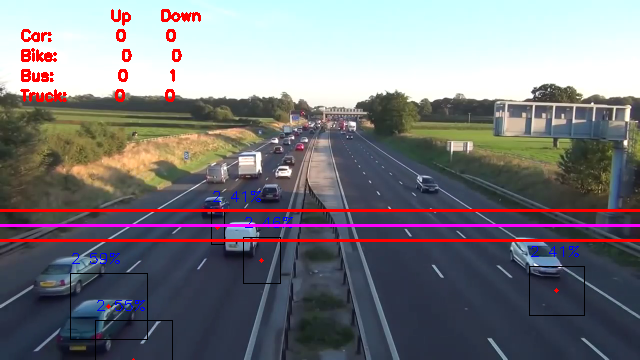

{'predictions': [{'x': 544.0, 'y': 266.0, 'width': 48, 'height': 64, 'class': '2', 'confidence': 0.503}, {'x': 242.5, 'y': 235.5, 'width': 35, 'height': 53, 'class': '2', 'confidence': 0.457}, {'x': 99.5, 'y': 318.5, 'width': 85, 'height': 83, 'class': '2', 'confidence': 0.438}, {'x': 70.0, 'y': 273.0, 'width': 76, 'height': 44, 'class': '2', 'confidence': 0.419}, {'x': 211.5, 'y': 210.0, 'width': 13, 'height': 30, 'class': '2', 'confidence': 0.412}]}


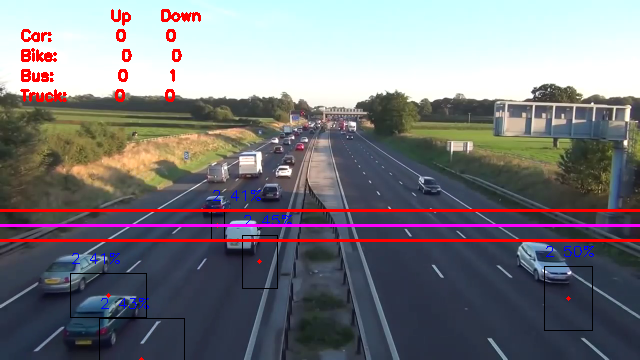

{'predictions': [{'x': 548.5, 'y': 269.0, 'width': 53, 'height': 74, 'class': '2', 'confidence': 0.605}, {'x': 105.5, 'y': 312.5, 'width': 79, 'height': 83, 'class': '2', 'confidence': 0.601}, {'x': 243.5, 'y': 233.0, 'width': 37, 'height': 50, 'class': '2', 'confidence': 0.487}, {'x': 78.5, 'y': 264.0, 'width': 73, 'height': 60, 'class': '2', 'confidence': 0.457}]}


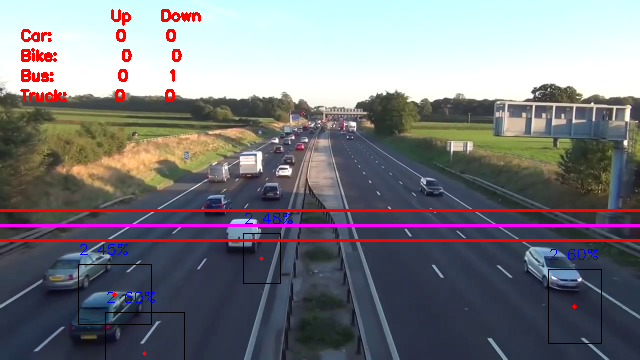

{'predictions': [{'x': 105.5, 'y': 312.5, 'width': 79, 'height': 83, 'class': '2', 'confidence': 0.613}, {'x': 548.5, 'y': 269.0, 'width': 53, 'height': 74, 'class': '2', 'confidence': 0.607}, {'x': 243.5, 'y': 233.0, 'width': 37, 'height': 50, 'class': '2', 'confidence': 0.49}, {'x': 78.5, 'y': 264.0, 'width': 73, 'height': 60, 'class': '2', 'confidence': 0.441}]}


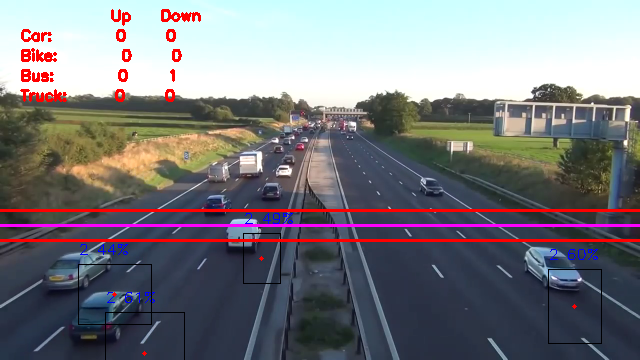

{'predictions': [{'x': 564.5, 'y': 271.5, 'width': 67, 'height': 79, 'class': '2', 'confidence': 0.673}, {'x': 83.5, 'y': 265.5, 'width': 77, 'height': 73, 'class': '2', 'confidence': 0.604}, {'x': 220.0, 'y': 204.5, 'width': 22, 'height': 21, 'class': '2', 'confidence': 0.484}, {'x': 106.5, 'y': 312.5, 'width': 71, 'height': 77, 'class': '2', 'confidence': 0.421}]}


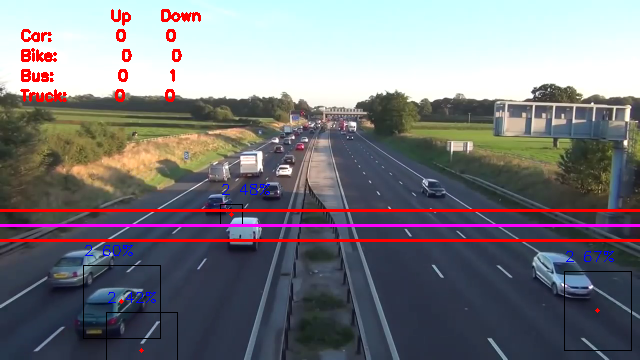

{'predictions': [{'x': 118.5, 'y': 302.0, 'width': 73, 'height': 94, 'class': '2', 'confidence': 0.595}, {'x': 572.0, 'y': 290.0, 'width': 52, 'height': 72, 'class': '2', 'confidence': 0.589}, {'x': 221.0, 'y': 204.0, 'width': 20, 'height': 20, 'class': '2', 'confidence': 0.436}, {'x': 246.5, 'y': 229.0, 'width': 37, 'height': 46, 'class': '2', 'confidence': 0.434}]}


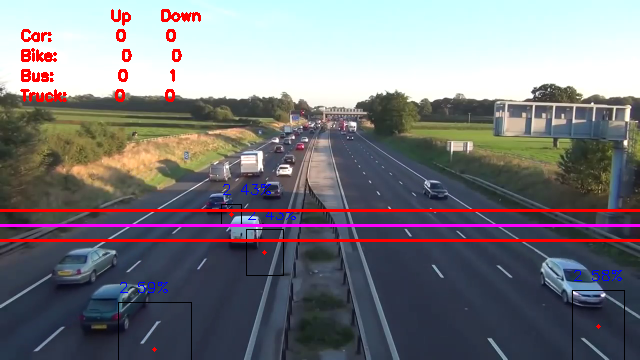

{'predictions': [{'x': 121.5, 'y': 301.5, 'width': 73, 'height': 95, 'class': '2', 'confidence': 0.716}, {'x': 579.0, 'y': 295.0, 'width': 54, 'height': 74, 'class': '2', 'confidence': 0.662}, {'x': 247.5, 'y': 227.5, 'width': 37, 'height': 59, 'class': '2', 'confidence': 0.491}]}


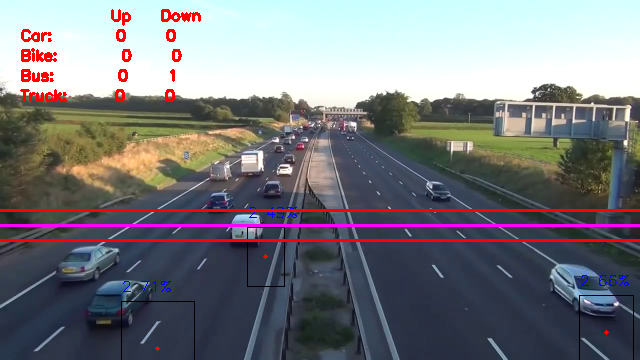

{'predictions': [{'x': 124.0, 'y': 295.5, 'width': 72, 'height': 83, 'class': '2', 'confidence': 0.705}, {'x': 595.0, 'y': 298.5, 'width': 66, 'height': 87, 'class': '2', 'confidence': 0.495}, {'x': 248.5, 'y': 227.5, 'width': 33, 'height': 59, 'class': '2', 'confidence': 0.484}]}


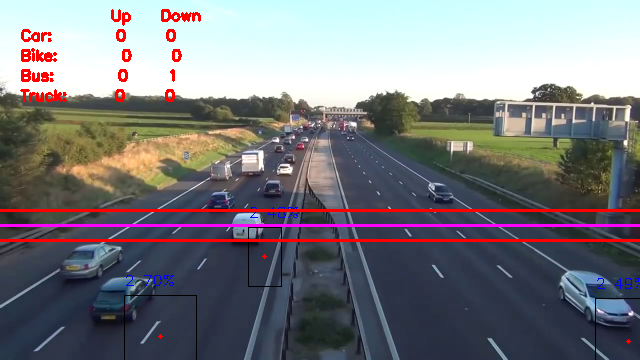

{'predictions': [{'x': 92.5, 'y': 260.0, 'width': 49, 'height': 50, 'class': '2', 'confidence': 0.592}, {'x': 604.0, 'y': 313.5, 'width': 60, 'height': 89, 'class': '2', 'confidence': 0.489}, {'x': 119.0, 'y': 296.0, 'width': 48, 'height': 72, 'class': '2', 'confidence': 0.469}, {'x': 249.5, 'y': 225.5, 'width': 31, 'height': 57, 'class': '2', 'confidence': 0.437}]}


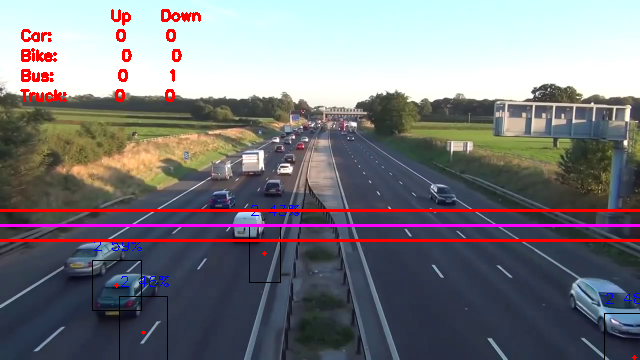

{'predictions': [{'x': 92.5, 'y': 260.0, 'width': 49, 'height': 52, 'class': '2', 'confidence': 0.589}, {'x': 604.0, 'y': 313.5, 'width': 60, 'height': 89, 'class': '2', 'confidence': 0.487}, {'x': 119.0, 'y': 296.0, 'width': 48, 'height': 72, 'class': '2', 'confidence': 0.467}, {'x': 249.5, 'y': 225.5, 'width': 31, 'height': 57, 'class': '2', 'confidence': 0.438}]}


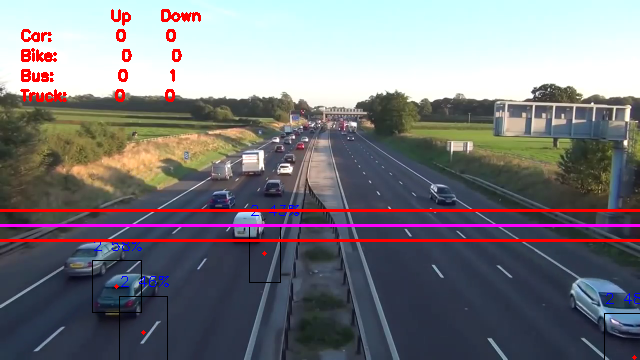

{'predictions': [{'x': 609.0, 'y': 310.0, 'width': 46, 'height': 100, 'class': '2', 'confidence': 0.512}, {'x': 96.5, 'y': 258.0, 'width': 51, 'height': 54, 'class': '2', 'confidence': 0.445}, {'x': 248.5, 'y': 225.0, 'width': 29, 'height': 54, 'class': '2', 'confidence': 0.439}, {'x': 129.0, 'y': 291.0, 'width': 58, 'height': 74, 'class': '2', 'confidence': 0.404}]}


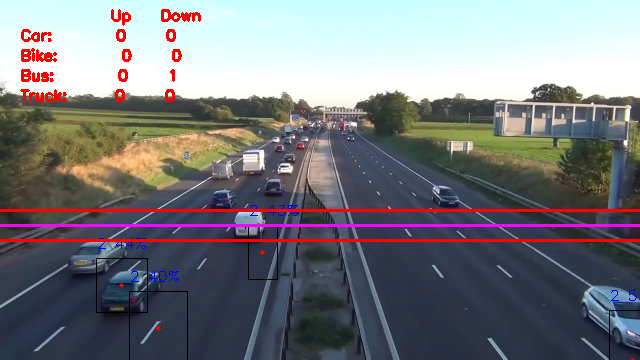

{'predictions': [{'x': 249.5, 'y': 221.5, 'width': 37, 'height': 43, 'class': '2', 'confidence': 0.568}, {'x': 133.0, 'y': 296.5, 'width': 48, 'height': 63, 'class': '2', 'confidence': 0.491}, {'x': 100.0, 'y': 250.5, 'width': 58, 'height': 43, 'class': '2', 'confidence': 0.43}]}


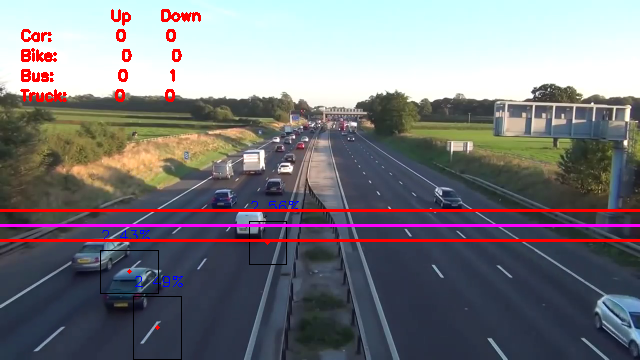

{'predictions': [{'x': 250.0, 'y': 220.0, 'width': 36, 'height': 46, 'class': '2', 'confidence': 0.593}, {'x': 136.0, 'y': 290.0, 'width': 48, 'height': 60, 'class': '2', 'confidence': 0.489}, {'x': 103.0, 'y': 252.0, 'width': 52, 'height': 52, 'class': '2', 'confidence': 0.41}]}


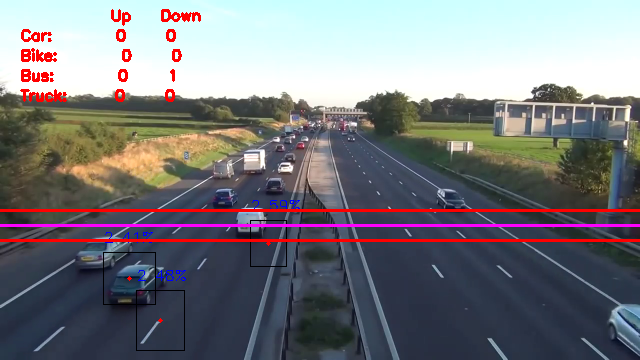

{'predictions': [{'x': 139.0, 'y': 282.5, 'width': 42, 'height': 69, 'class': '2', 'confidence': 0.62}, {'x': 253.0, 'y': 219.0, 'width': 30, 'height': 48, 'class': '2', 'confidence': 0.534}, {'x': 106.0, 'y': 250.5, 'width': 46, 'height': 49, 'class': '2', 'confidence': 0.495}]}


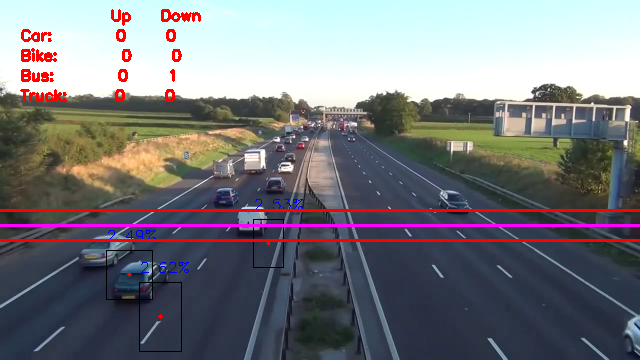

{'predictions': [{'x': 107.0, 'y': 250.5, 'width': 44, 'height': 49, 'class': '2', 'confidence': 0.497}, {'x': 143.5, 'y': 280.5, 'width': 43, 'height': 69, 'class': '2', 'confidence': 0.489}]}


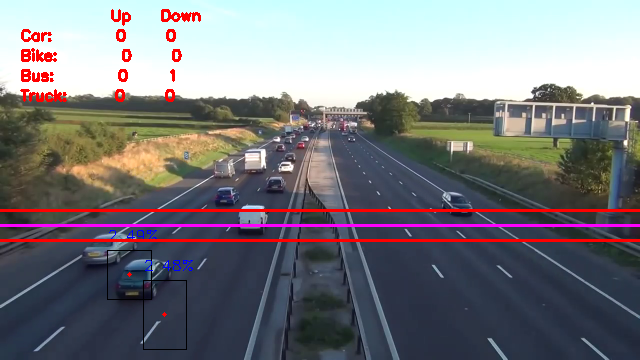

{'predictions': [{'x': 106.5, 'y': 250.5, 'width': 43, 'height': 49, 'class': '2', 'confidence': 0.502}, {'x': 143.5, 'y': 280.5, 'width': 43, 'height': 69, 'class': '2', 'confidence': 0.484}]}


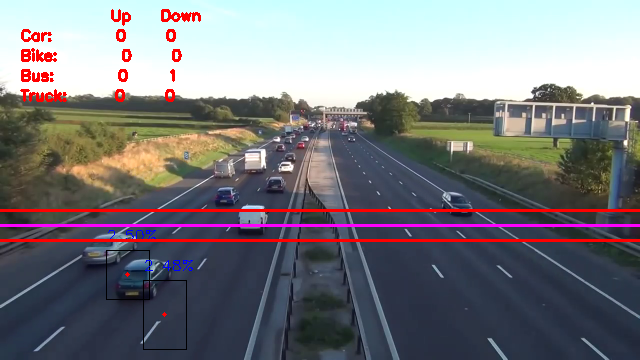

{'predictions': [{'x': 146.5, 'y': 277.0, 'width': 49, 'height': 64, 'class': '2', 'confidence': 0.453}, {'x': 457.5, 'y': 206.5, 'width': 35, 'height': 31, 'class': '2', 'confidence': 0.415}]}


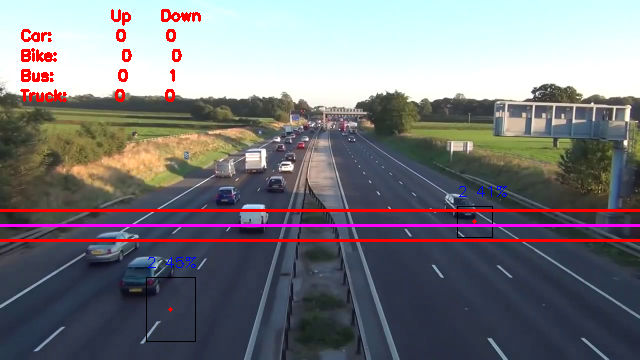

{'predictions': [{'x': 150.0, 'y': 271.5, 'width': 56, 'height': 73, 'class': '2', 'confidence': 0.47}, {'x': 256.0, 'y': 214.0, 'width': 26, 'height': 40, 'class': '2', 'confidence': 0.424}, {'x': 464.5, 'y': 210.0, 'width': 31, 'height': 24, 'class': '2', 'confidence': 0.41}]}


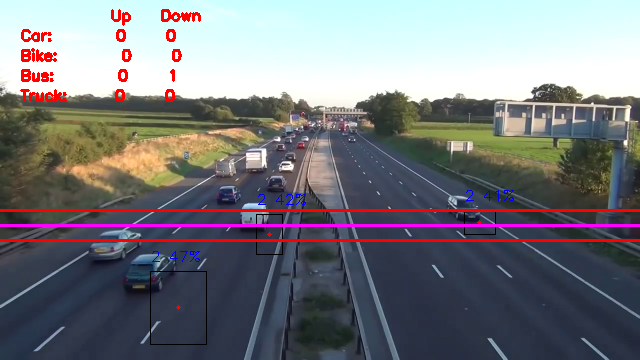

{'predictions': [{'x': 151.5, 'y': 271.0, 'width': 51, 'height': 62, 'class': '2', 'confidence': 0.556}, {'x': 258.5, 'y': 214.5, 'width': 27, 'height': 41, 'class': '2', 'confidence': 0.461}, {'x': 465.5, 'y': 210.5, 'width': 39, 'height': 43, 'class': '2', 'confidence': 0.403}]}


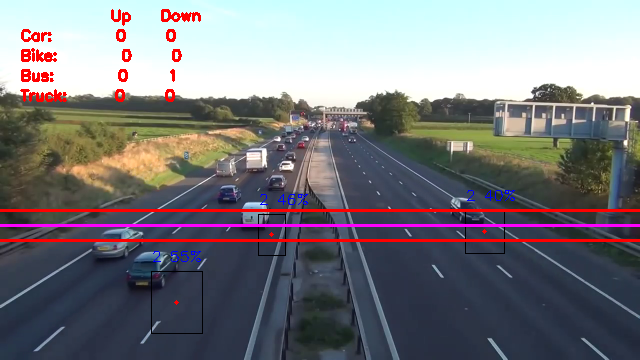

{'predictions': [{'x': 121.5, 'y': 239.5, 'width': 65, 'height': 57, 'class': '2', 'confidence': 0.495}, {'x': 469.0, 'y': 211.5, 'width': 40, 'height': 41, 'class': '2', 'confidence': 0.467}, {'x': 151.5, 'y': 266.5, 'width': 51, 'height': 63, 'class': '2', 'confidence': 0.448}, {'x': 259.0, 'y': 214.0, 'width': 20, 'height': 40, 'class': '2', 'confidence': 0.443}]}


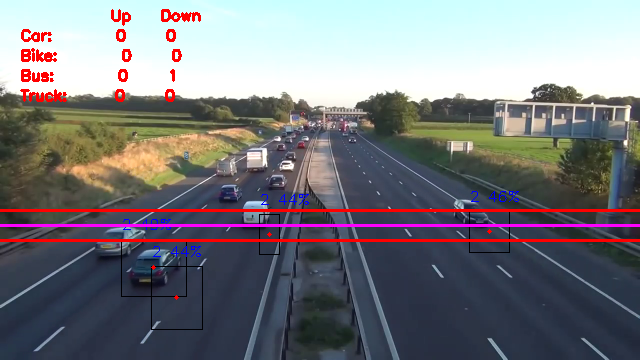

{'predictions': [{'x': 123.5, 'y': 236.5, 'width': 63, 'height': 57, 'class': '2', 'confidence': 0.487}, {'x': 260.0, 'y': 212.5, 'width': 18, 'height': 43, 'class': '2', 'confidence': 0.475}, {'x': 152.5, 'y': 265.0, 'width': 49, 'height': 66, 'class': '2', 'confidence': 0.43}]}


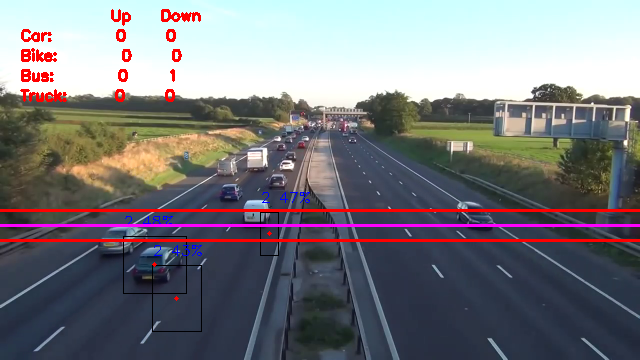

{'predictions': [{'x': 123.5, 'y': 236.5, 'width': 63, 'height': 57, 'class': '2', 'confidence': 0.484}, {'x': 260.0, 'y': 212.5, 'width': 18, 'height': 43, 'class': '2', 'confidence': 0.467}, {'x': 152.5, 'y': 266.0, 'width': 49, 'height': 64, 'class': '2', 'confidence': 0.426}]}


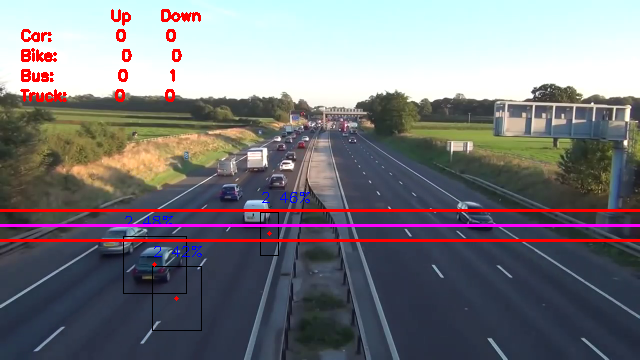

{'predictions': [{'x': 155.5, 'y': 261.5, 'width': 43, 'height': 61, 'class': '2', 'confidence': 0.604}, {'x': 125.0, 'y': 237.0, 'width': 60, 'height': 56, 'class': '2', 'confidence': 0.511}, {'x': 259.0, 'y': 211.0, 'width': 20, 'height': 40, 'class': '2', 'confidence': 0.434}]}


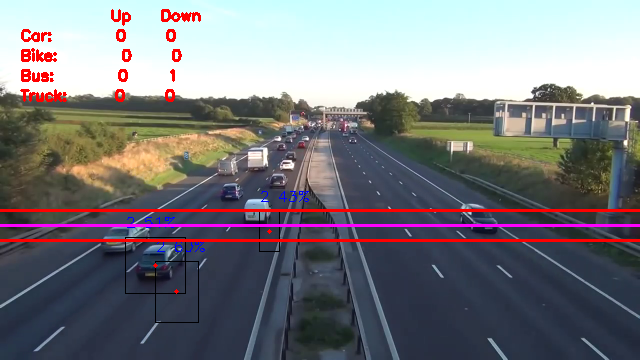

{'predictions': [{'x': 156.0, 'y': 259.0, 'width': 44, 'height': 60, 'class': '2', 'confidence': 0.624}, {'x': 260.5, 'y': 212.5, 'width': 17, 'height': 43, 'class': '2', 'confidence': 0.419}, {'x': 129.5, 'y': 236.5, 'width': 49, 'height': 43, 'class': '2', 'confidence': 0.402}]}


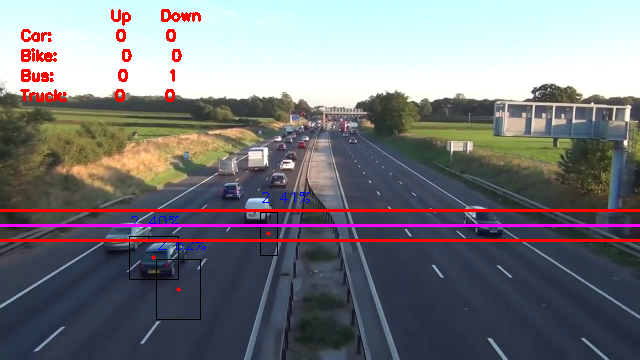

{'predictions': [{'x': 260.5, 'y': 211.0, 'width': 17, 'height': 46, 'class': '2', 'confidence': 0.631}, {'x': 160.0, 'y': 257.5, 'width': 36, 'height': 57, 'class': '2', 'confidence': 0.613}, {'x': 130.5, 'y': 236.5, 'width': 43, 'height': 57, 'class': '2', 'confidence': 0.547}, {'x': 485.5, 'y': 224.5, 'width': 51, 'height': 49, 'class': '2', 'confidence': 0.4}]}


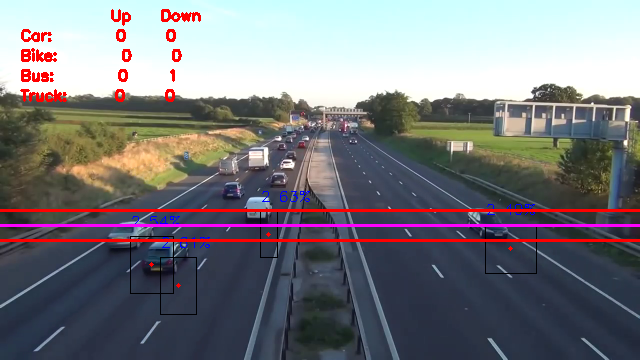

{'predictions': [{'x': 166.5, 'y': 255.5, 'width': 37, 'height': 59, 'class': '2', 'confidence': 0.566}, {'x': 491.0, 'y': 228.5, 'width': 40, 'height': 51, 'class': '2', 'confidence': 0.544}, {'x': 131.5, 'y': 233.0, 'width': 35, 'height': 50, 'class': '2', 'confidence': 0.517}, {'x': 260.5, 'y': 210.5, 'width': 17, 'height': 43, 'class': '2', 'confidence': 0.46}]}


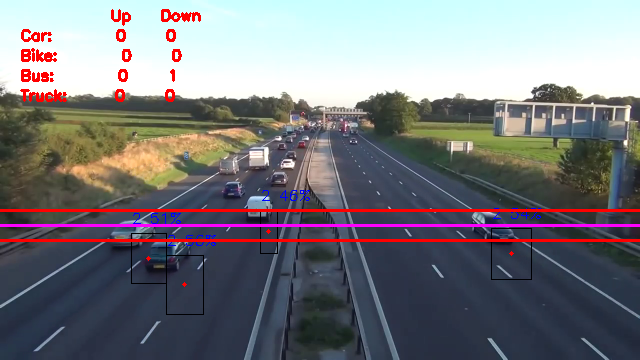

{'predictions': [{'x': 131.5, 'y': 232.5, 'width': 33, 'height': 49, 'class': '2', 'confidence': 0.541}, {'x': 167.0, 'y': 254.0, 'width': 38, 'height': 62, 'class': '2', 'confidence': 0.529}, {'x': 260.5, 'y': 207.0, 'width': 23, 'height': 38, 'class': '2', 'confidence': 0.417}, {'x': 495.0, 'y': 231.0, 'width': 54, 'height': 58, 'class': '2', 'confidence': 0.414}]}


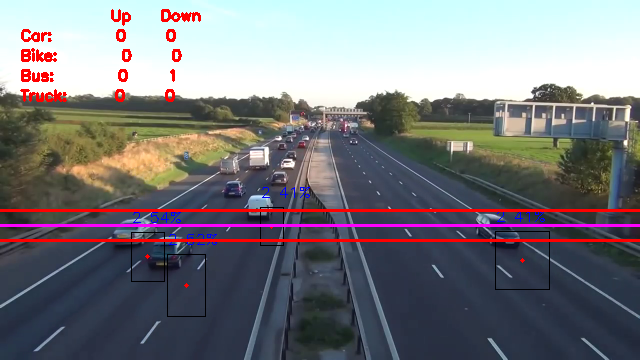

{'predictions': [{'x': 131.5, 'y': 232.5, 'width': 33, 'height': 49, 'class': '2', 'confidence': 0.538}, {'x': 167.0, 'y': 254.0, 'width': 38, 'height': 62, 'class': '2', 'confidence': 0.523}, {'x': 260.5, 'y': 207.0, 'width': 23, 'height': 38, 'class': '2', 'confidence': 0.418}, {'x': 495.5, 'y': 231.0, 'width': 53, 'height': 58, 'class': '2', 'confidence': 0.417}]}


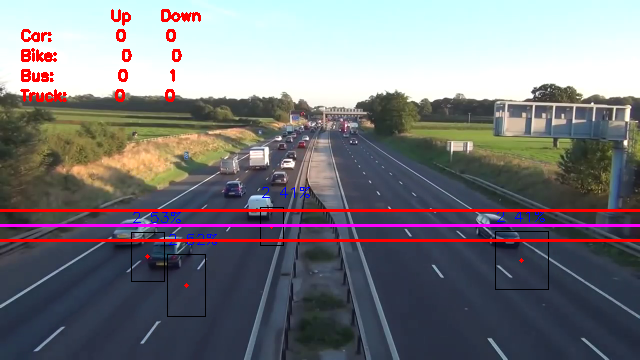

{'predictions': [{'x': 499.0, 'y': 232.5, 'width': 38, 'height': 59, 'class': '2', 'confidence': 0.654}, {'x': 168.5, 'y': 250.0, 'width': 41, 'height': 60, 'class': '2', 'confidence': 0.435}, {'x': 134.5, 'y': 230.5, 'width': 33, 'height': 49, 'class': '2', 'confidence': 0.404}]}


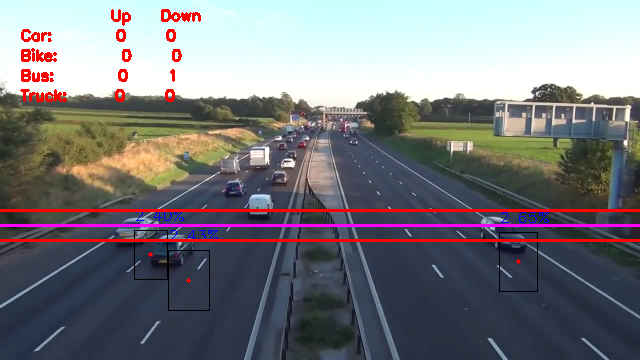

{'predictions': [{'x': 138.5, 'y': 229.0, 'width': 37, 'height': 46, 'class': '2', 'confidence': 0.473}, {'x': 504.0, 'y': 237.5, 'width': 36, 'height': 63, 'class': '2', 'confidence': 0.457}]}


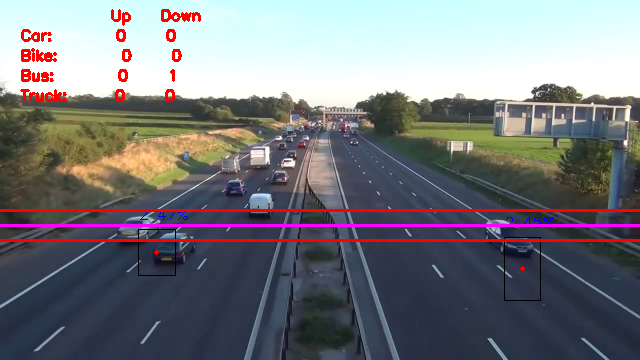

{'predictions': [{'x': 142.5, 'y': 227.5, 'width': 39, 'height': 43, 'class': '2', 'confidence': 0.47}, {'x': 508.5, 'y': 243.0, 'width': 39, 'height': 68, 'class': '2', 'confidence': 0.462}]}


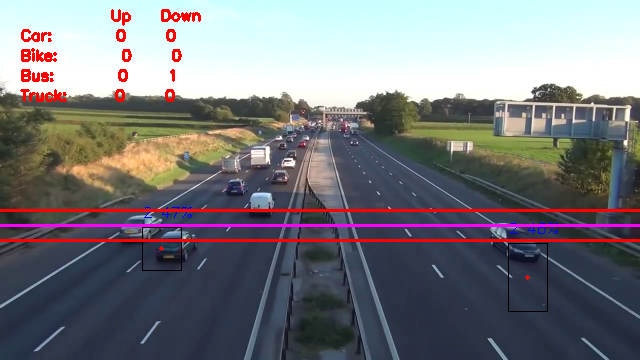

{'predictions': [{'x': 520.0, 'y': 249.0, 'width': 50, 'height': 62, 'class': '2', 'confidence': 0.477}, {'x': 146.5, 'y': 227.0, 'width': 49, 'height': 30, 'class': '2', 'confidence': 0.409}]}


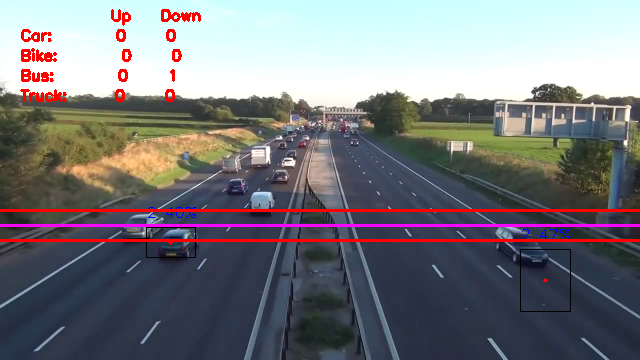

{'predictions': [{'x': 521.5, 'y': 254.5, 'width': 49, 'height': 69, 'class': '2', 'confidence': 0.521}, {'x': 147.0, 'y': 227.0, 'width': 44, 'height': 48, 'class': '2', 'confidence': 0.419}]}


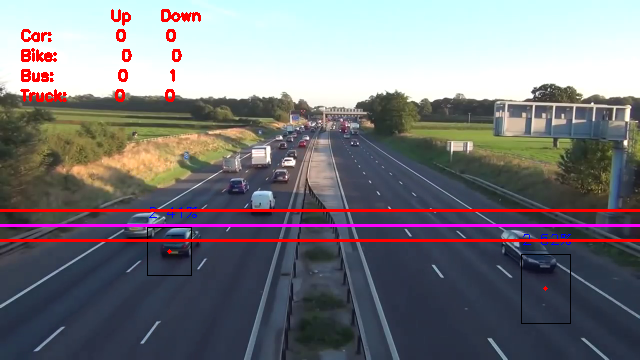

{'predictions': [{'x': 521.5, 'y': 254.5, 'width': 49, 'height': 69, 'class': '2', 'confidence': 0.523}, {'x': 147.0, 'y': 227.0, 'width': 44, 'height': 48, 'class': '2', 'confidence': 0.423}]}


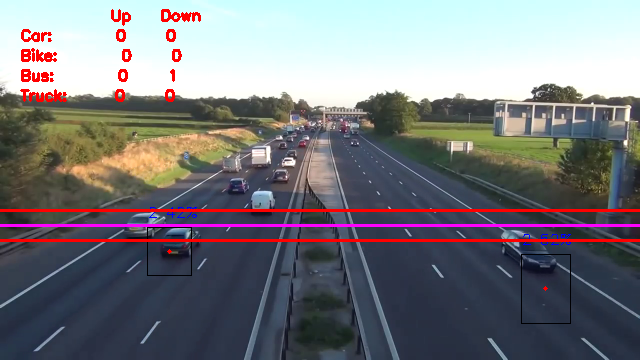

{'predictions': [{'x': 537.0, 'y': 254.5, 'width': 64, 'height': 75, 'class': '2', 'confidence': 0.604}, {'x': 147.5, 'y': 225.5, 'width': 43, 'height': 45, 'class': '2', 'confidence': 0.451}]}


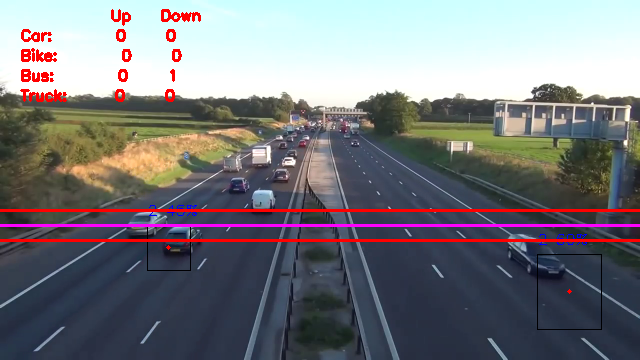

{'predictions': [{'x': 541.5, 'y': 258.0, 'width': 49, 'height': 72, 'class': '2', 'confidence': 0.469}, {'x': 178.5, 'y': 236.0, 'width': 31, 'height': 60, 'class': '2', 'confidence': 0.433}]}


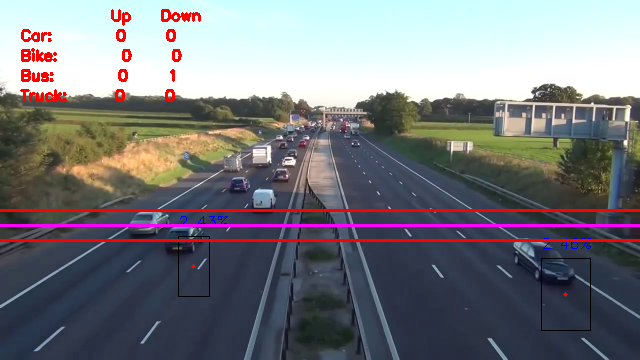

{'predictions': [{'x': 551.0, 'y': 262.0, 'width': 68, 'height': 88, 'class': '2', 'confidence': 0.629}, {'x': 176.0, 'y': 234.0, 'width': 44, 'height': 58, 'class': '2', 'confidence': 0.443}]}


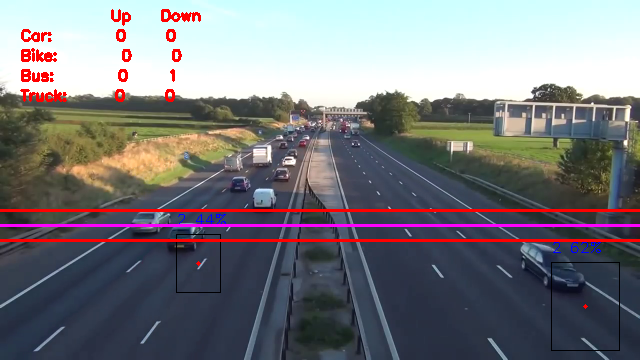

{'predictions': [{'x': 181.5, 'y': 232.0, 'width': 31, 'height': 52, 'class': '2', 'confidence': 0.632}, {'x': 556.5, 'y': 273.0, 'width': 57, 'height': 70, 'class': '2', 'confidence': 0.578}]}
Buffered data was truncated after reaching the output size limit.

In [22]:
realTime()